# **Final Project: Complex Networks Theory and Applications (MAT933)**

Istitution: University of Zurich and Università degli studi di Torino  
Autor: **Stefano Sperti**

# Title : Measuring the Effictiveness of Hypergraph Community Detection


In [1]:
import sys
import os
import importlib

data_path = '../data/'

In [2]:
import hypergraphx as hx
from hypergraphx.core.hypergraph import Hypergraph
from hypergraphx.utils import normalize_array, calculate_permutation_matrix
from hypergraphx.communities.hy_sc.model import HySC
from hypergraphx.communities.hypergraph_mt.model import HypergraphMT
from hypergraphx.communities.hy_mmsbm.model import HyMMSBM
from hypergraphx.viz import draw_communities


import networkx as nx

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns

from k_clique_reduction import k_clique_reduction
from metrix import *
from modularity_graph import *
from bipartite_reduction import *
from methods_clustering import *
from evaluation_clustering import *

In [3]:
from import_graph import *
from empirical_analysis import *

# Hospital

In [4]:
file_path_hospital = '../data/hospital/hospital.npz'
file_path_ground_truth_hospital = '../data/hospital/hospital_meta.csv'
hyperedges_hospital = import_from_npz(file_path_hospital)


In [5]:
data = pd.read_csv(file_path_ground_truth_hospital)
true_community = {}
true_matrix = {}
for i in range(len(data)):
    if data['classID'][i] not in true_community:
        true_community[data['classID'][i]] = []
    true_community[data['classID'][i]].append(data['nodeID'][i])
    true_matrix[data['nodeID'][i]] = data['classID'][i]

number_community = len(true_community)
matrix = np.zeros((len(true_matrix), number_community))
for i in range(len(true_matrix)):
    matrix[i][true_matrix[i]-1] = 1

true_partition_hospital = true_community
true_matrix_hospital = matrix

In [6]:
number_community = true_matrix_hospital.shape[1]
print("True number of communities hospital: ", number_community)
min_number = 3
max_number = 8

True number of communities hospital:  4


The number of nodes is 75


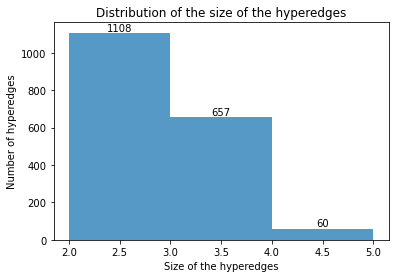

<Figure size 432x288 with 0 Axes>

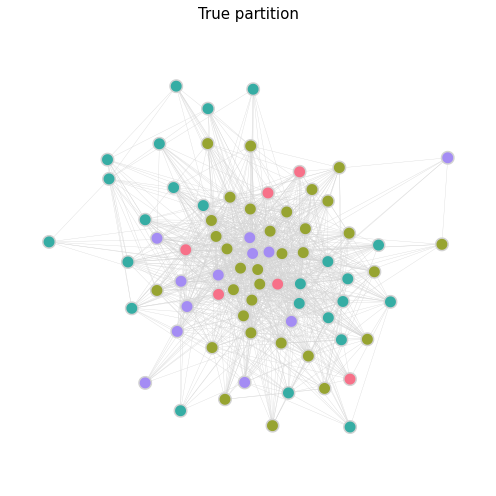

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


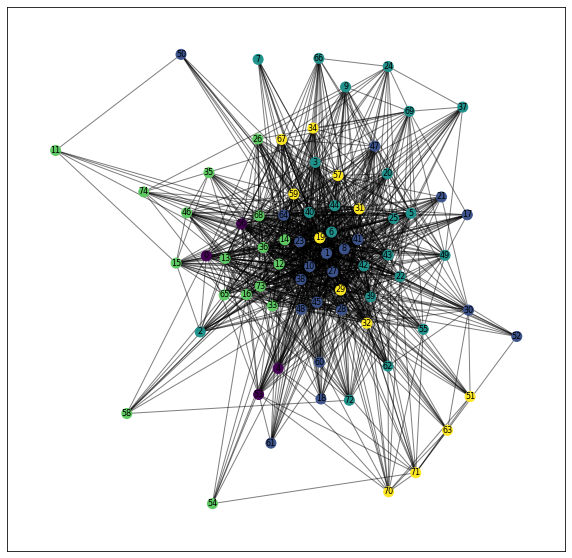

Adjusted Rand Index (ARI): 0.040258806613946804
Normalized Mutual Information (NMI): 0.05186992810865848
Conductance: 0.7405350700838278
Generalized Conductance: 4.837113525512305


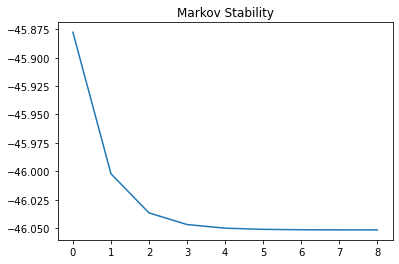

Number of partitions of K -clique reduction:  5
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.012046582759627614
Normalized Mutual Information (NMI): 0.03914065751823873
Conductance: 0.7313304692816116
Generalized Conductance: 4.865056474176509


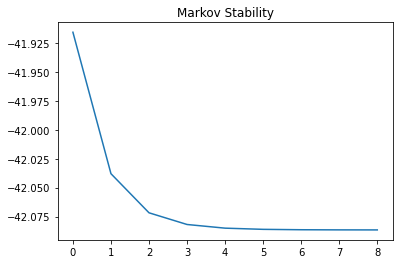

Number of partitions of K -clique reduction weighting the hyperedges:  5
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.03688582131043507
Normalized Mutual Information (NMI): 0.07377401663697589
Conductance: 0.8865493523586984
Generalized Conductance: 4.40519119781548
Number of partitions:  15
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.016547509225092252
Normalized Mutual Information (NMI): 0.059426387849110744
Conductance: 0.921598724530548
Generalized Conductance: 5.352354532203357
Number of partitions:  21
-----------------------------------------------------------------------------------
Spectral clustering with number of com

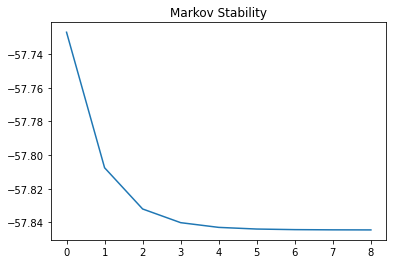

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.004521572686966542
Normalized Mutual Information (NMI): 0.0495293624858838
Conductance: 0.7488175692464476
Generalized Conductance: 5.320156825218236


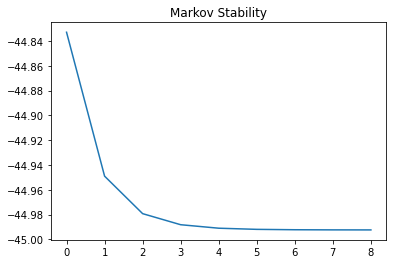

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


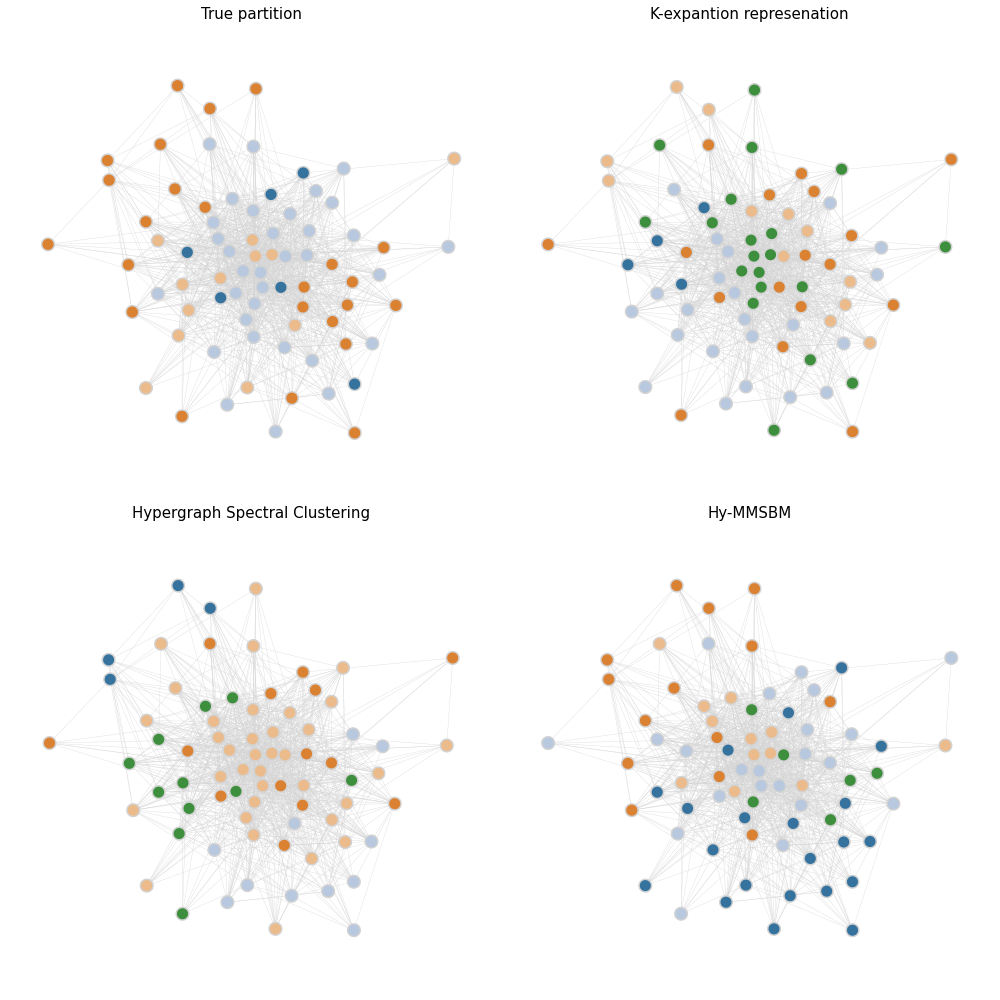

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.09520236000414035
Normalized Mutual Information (NMI): 0.08722452664897767
Conductance: 0.7157050889393304
Generalized Conductance: 3.5865947046821636


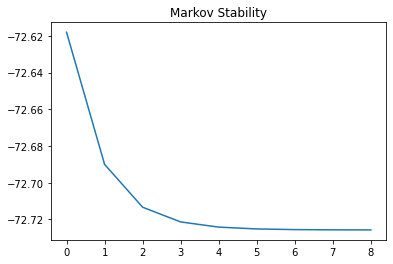

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.021810971579643092
Normalized Mutual Information (NMI): 0.06476826486460117
Conductance: 0.6951824823929286
Generalized Conductance: 5.119464562090413


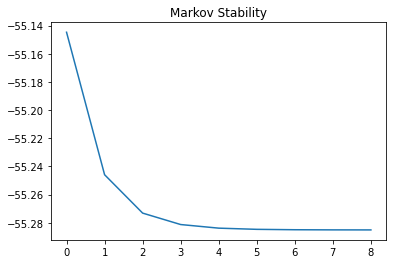

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


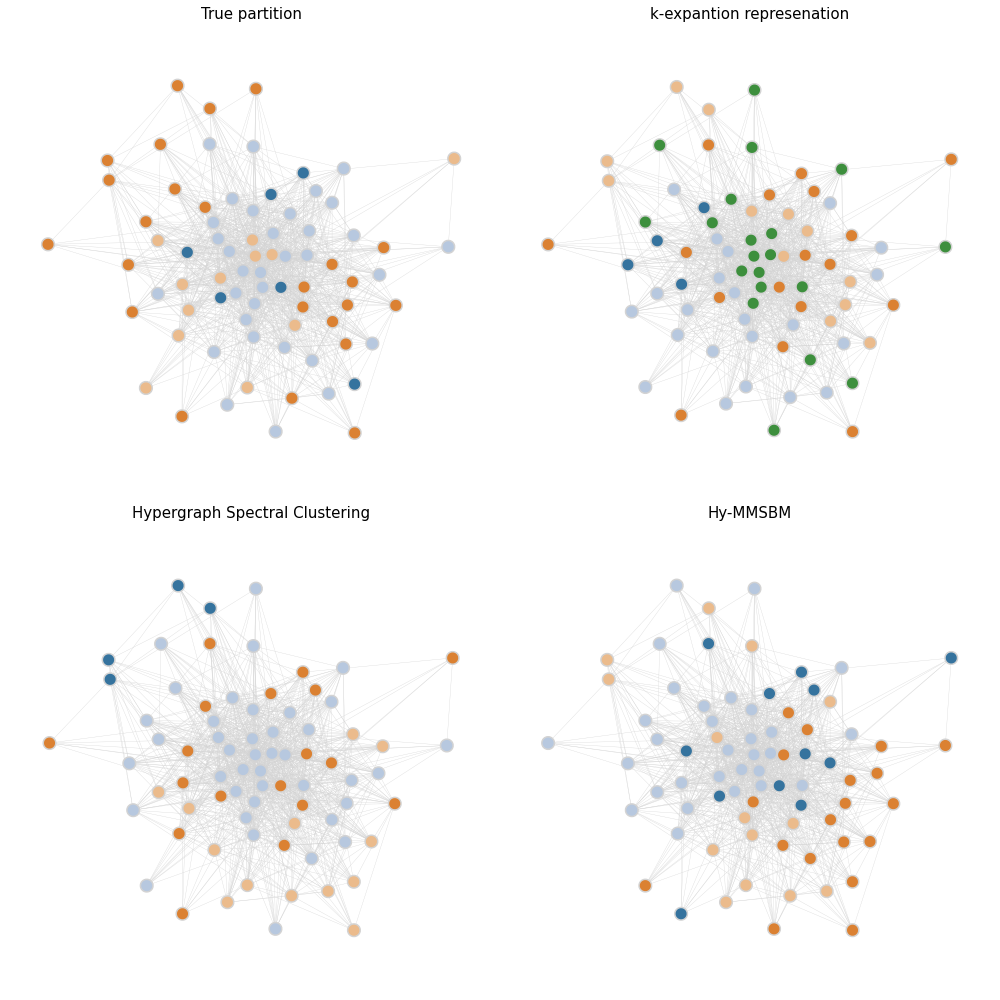

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


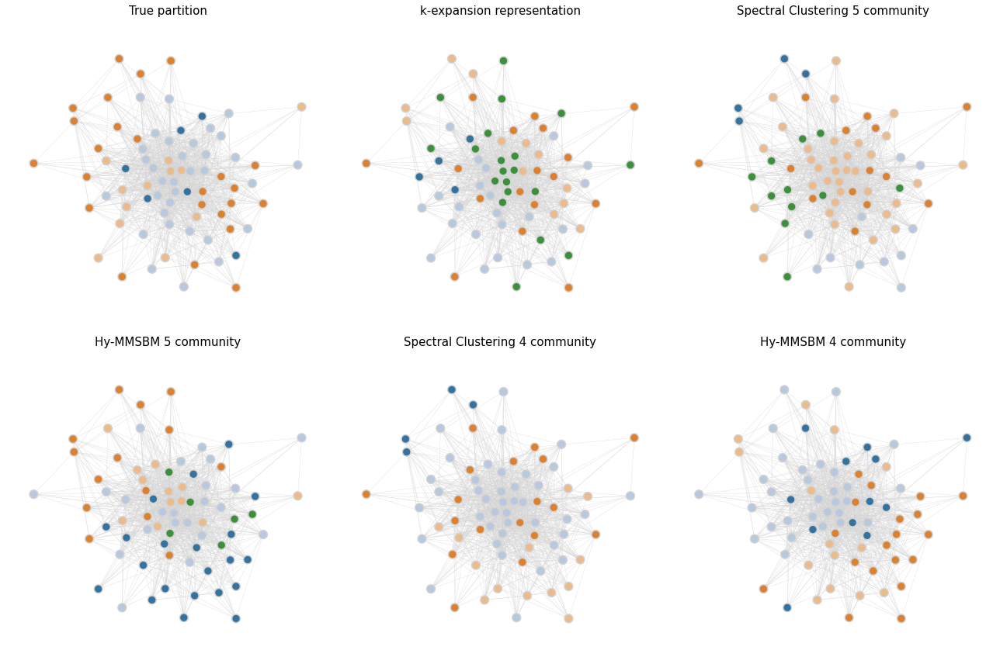

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  3
Adjusted Rand Index (ARI): 0.0556751768686558
Normalized Mutual Information (NMI): 0.07624679600287354
Conductance: 0.6037575420031561
Generalized Conductance: 2.621568919003426
Number of communities:  4
Adjusted Rand Index (ARI): 0.09520236000414035
Normalized Mutual Information (NMI): 0.08722452664897767
Conductance: 0.7157050889393304
Generalized Conductance: 3.5865947046821636
Number of communities:  5
Adjusted Rand Index (ARI): 0.09737007895741266
Normalized Mutual Information (NMI): 0.08994989393081604
Conductance: 0.7338776752138381
Generalized Conductance: 3.175509746312945
Number of communities:  6
Adjusted Rand Index (ARI): 0.051181159455317995
Normalized Mutual Information (NMI): 0.07397011724465706
Conductance: 0.7624079213748253
Generalized Conductanc

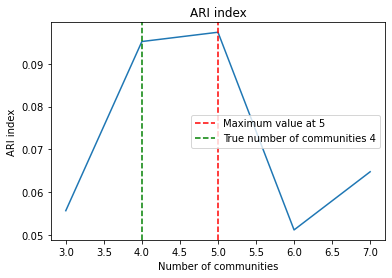

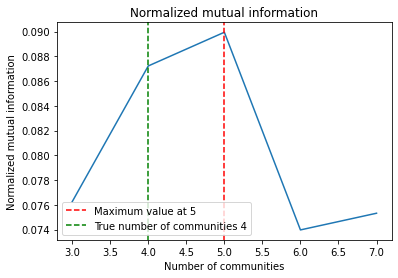

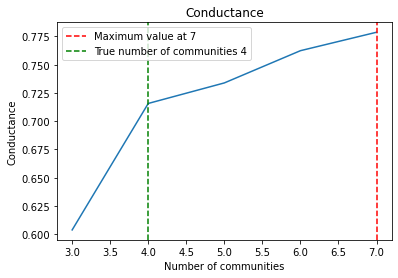

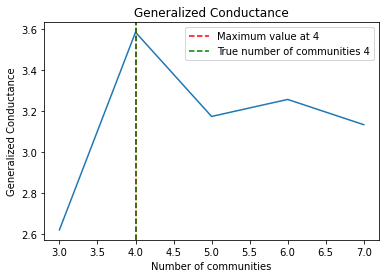

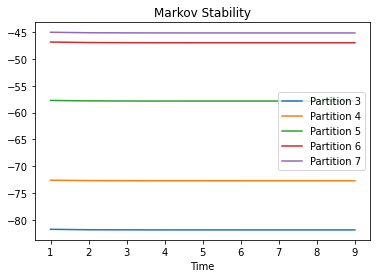

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.01204669647292598
Normalized Mutual Information (NMI): 0.033904577640548605
Conductance: 0.685412769588817
Generalized Conductance: 5.185599652722203
Adjusted Rand Index (ARI): 0.06546116989882936
Normalized Mutual Information (NMI): 0.057198261222542804
Conductance: 0.6736188117895974
Generalized Conductance: 4.641776598550826
Adjusted Rand Index (ARI): -0.0030516184133503508
Normalized Mutual Information (NMI): 0.03333865080041412
Conductance: 0.6797593068380682
Generalized Conductance: 5.103782069820927
Adjusted Rand Index (ARI): 0.014539285258222814
Normalized Mutual Information (NMI): 0.04140559325546266
Conductance: 0.6919212362344638
Generalized Conductance: 5.371759383986859
Adjusted Rand Index (ARI): 0.0268788121840667
Normalized Mutual Information (NMI): 0.055771

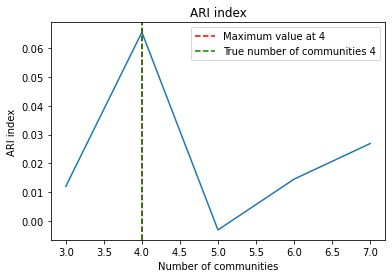

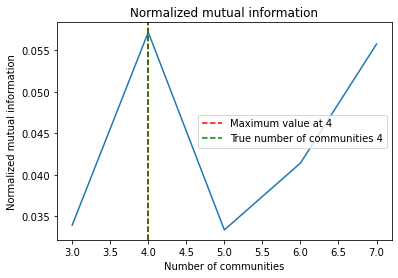

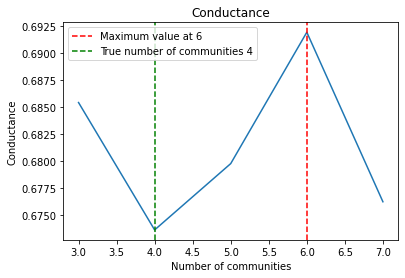

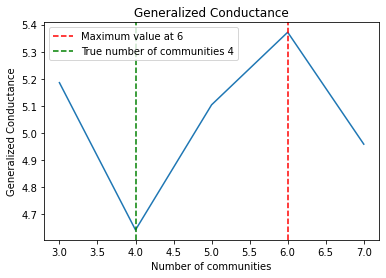

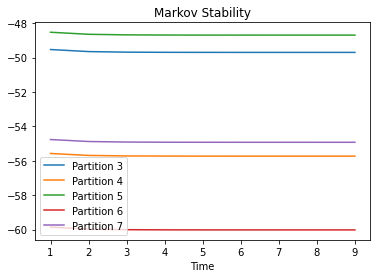

In [7]:
empirical_analysis_project(hyperedges_hospital, true_partition_hospital,
                           true_matrix_hospital, min_number, max_number, number_community,number_community)

## Primary school


In [8]:
file_path_primary_school = data_path + \
    "contact-primary-school-classes/hyperedges-contact-primary-school-classes.txt"
file_true_partition_primary_school = data_path + \
    "contact-primary-school-classes/node-labels-contact-primary-school-classes.txt"

true_partition_primary_school, true_matrix_primary_school = import_txt_true_one_community(
    file_true_partition_primary_school)
primary_school = import_txt_comma_hypergraph(file_path_primary_school)

n_community = true_matrix_primary_school.shape[1]
print("True number of communities high school: ",
      true_matrix_primary_school.shape[1])

True number of communities high school:  11


In [9]:
min_number = 3
max_number = 15
K = 11

The number of nodes is 242


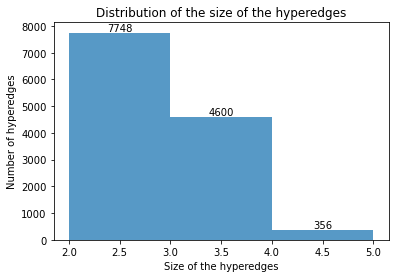

<Figure size 432x288 with 0 Axes>

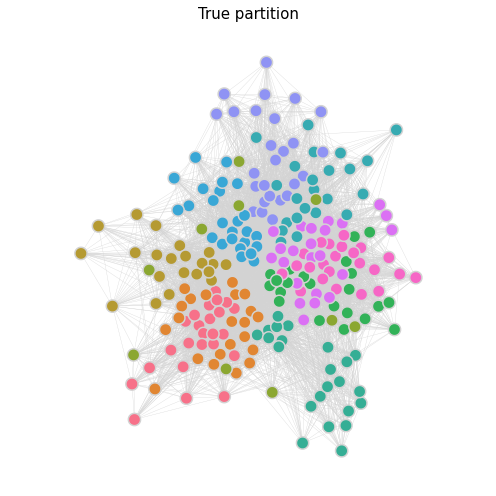

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


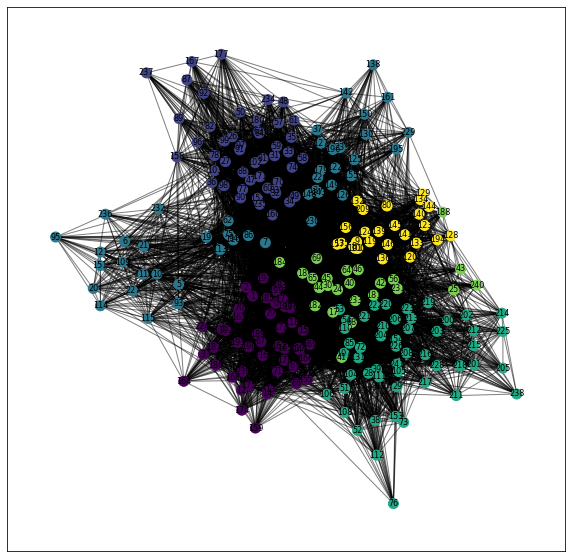

Adjusted Rand Index (ARI): 0.6232310651890034
Normalized Mutual Information (NMI): 0.5075837099598485
Conductance: 0.5658700270982044
Generalized Conductance: 3.0401893140026672


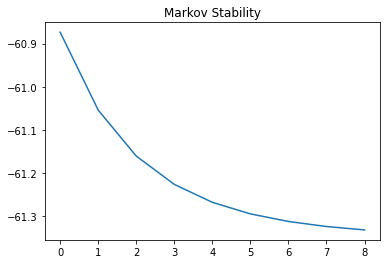

Number of partitions of K -clique reduction:  6
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.6232310651890034
Normalized Mutual Information (NMI): 0.5075837099598485
Conductance: 0.5658700270982044
Generalized Conductance: 3.0401893140026672


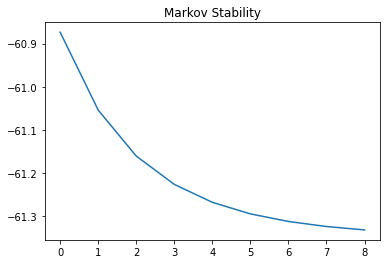

Number of partitions of K -clique reduction weighting the hyperedges:  6
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8379610746433784
Normalized Mutual Information (NMI): 0.7890943373728343
Conductance: 0.6356157810754091
Generalized Conductance: 3.079328966598953
Number of partitions:  9
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8466049098507524
Normalized Mutual Information (NMI): 0.8005554739600168
Conductance: 0.6342321688901629
Generalized Conductance: 3.8219534907004027
Number of partitions:  9
-----------------------------------------------------------------------------------
Spectral clustering with number of communit

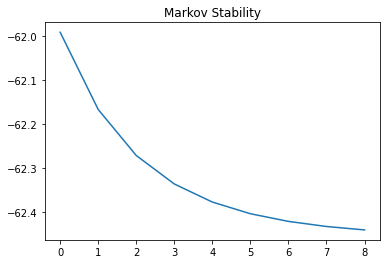

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.6023799339631533
Normalized Mutual Information (NMI): 0.479996449322397
Conductance: 0.5704862874932235
Generalized Conductance: 2.6326306221880227


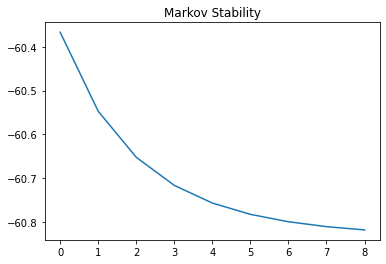

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


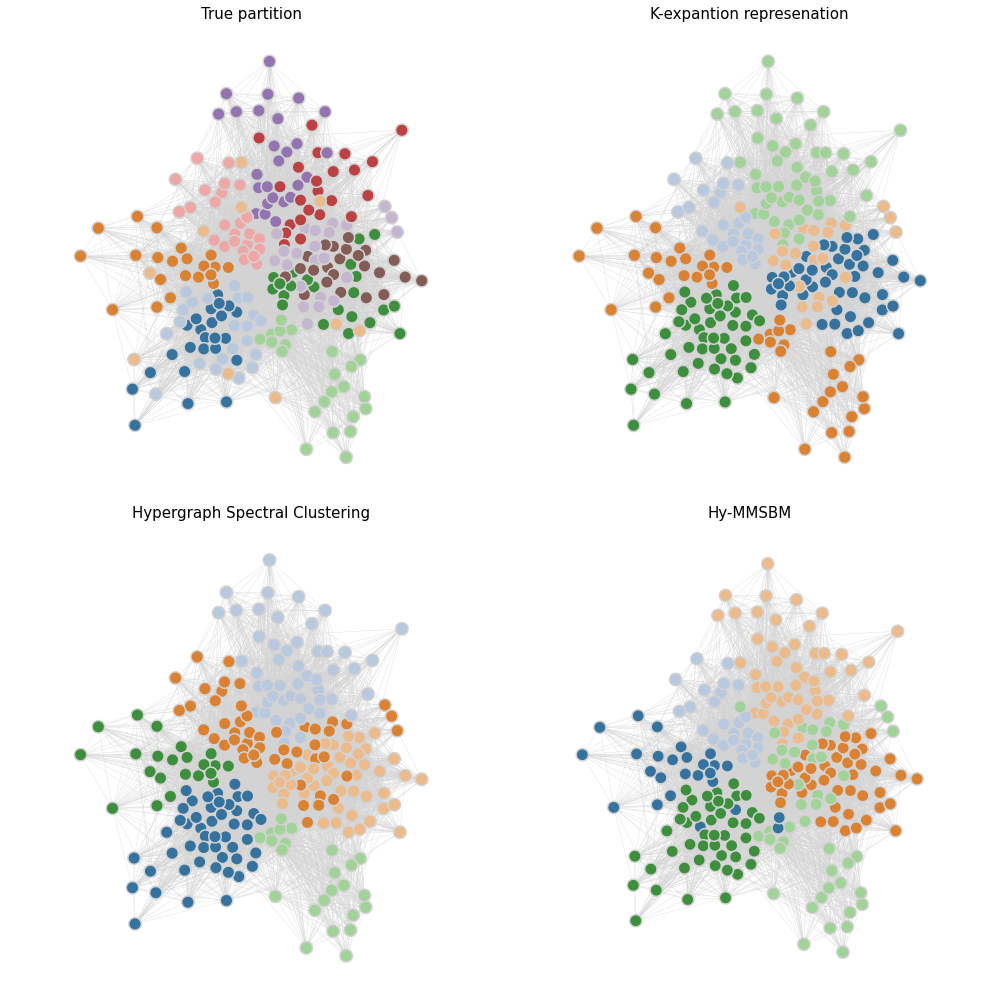

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.907825407935329
Normalized Mutual Information (NMI): 0.8494983528409861
Conductance: 0.6957906336200893
Generalized Conductance: 4.314147686652095


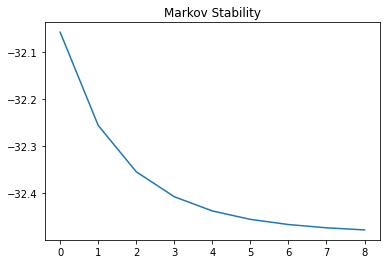

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.9108880814504151
Normalized Mutual Information (NMI): 0.852064999850505
Conductance: 0.6949125576588184
Generalized Conductance: 3.7590979083255305


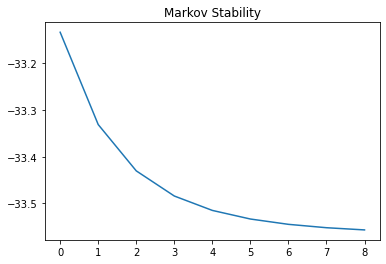

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


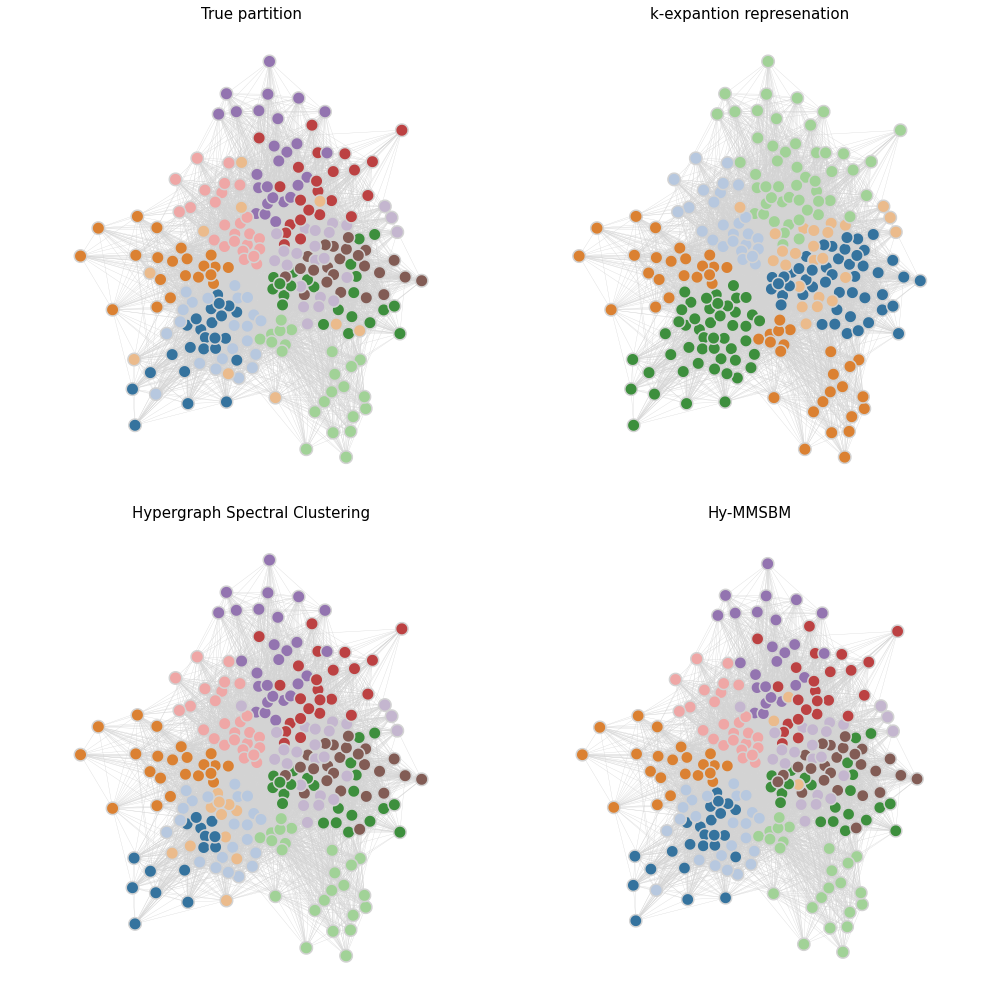

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


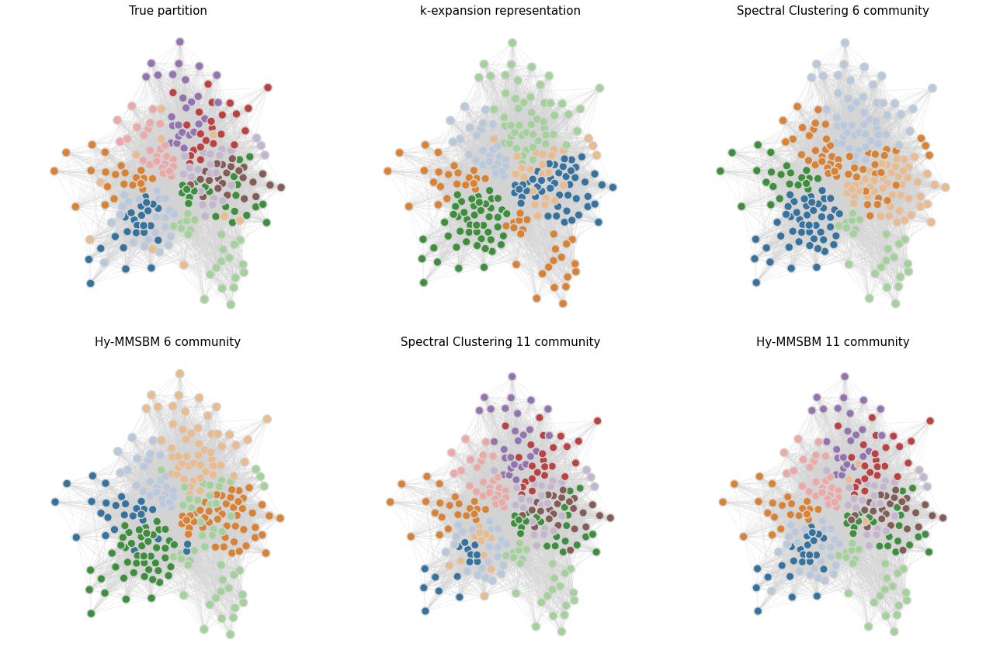

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  3
Adjusted Rand Index (ARI): 0.285749158894742
Normalized Mutual Information (NMI): 0.20188825636660374
Conductance: 0.3958208613216944
Generalized Conductance: 0.8889128383306891
Number of communities:  4
Adjusted Rand Index (ARI): 0.391595985577681
Normalized Mutual Information (NMI): 0.3127558769441448
Conductance: 0.46419375539513547
Generalized Conductance: 1.4360050742097012
Number of communities:  5
Adjusted Rand Index (ARI): 0.5431941376191115
Normalized Mutual Information (NMI): 0.3952684261690896
Conductance: 0.523550966167372
Generalized Conductance: 1.8578641151721382
Number of communities:  6
Adjusted Rand Index (ARI): 0.6136216535148511
Normalized Mutual Information (NMI): 0.4997666026905708
Conductance: 0.5493840122629242
Generalized Conductance: 2.30

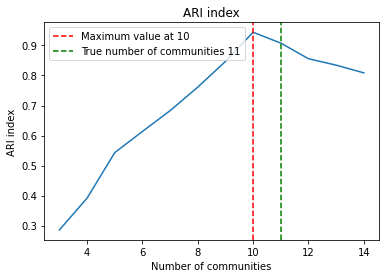

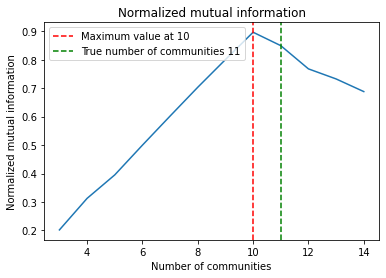

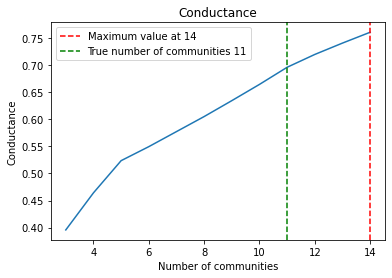

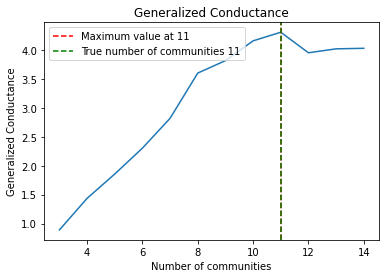

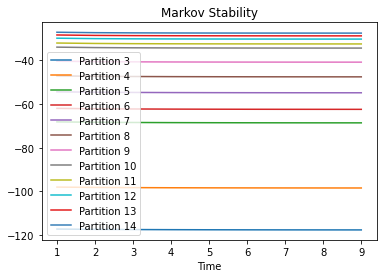

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8401384088485888
Normalized Mutual Information (NMI): 0.7715033839327936
Conductance: 0.69713895324557
Generalized Conductance: 3.732886924517786
Adjusted Rand Index (ARI): 0.8187849251950408
Normalized Mutual Information (NMI): 0.756997346360633
Conductance: 0.7004739191935787
Generalized Conductance: 3.634798308633501
Adjusted Rand Index (ARI): 0.9024236174717705
Normalized Mutual Information (NMI): 0.8425617101373601
Conductance: 0.6938907049464641
Generalized Conductance: 4.184094619421509
Adjusted Rand Index (ARI): 0.8691984138621358
Normalized Mutual Information (NMI): 0.8008980163882106
Conductance: 0.6934425333476611
Generalized Conductance: 4.313696353882069
Adjusted Rand Index (ARI): 0.8982216752173692
Normalized Mutual Information (NMI): 0.8395704747275848
Condu

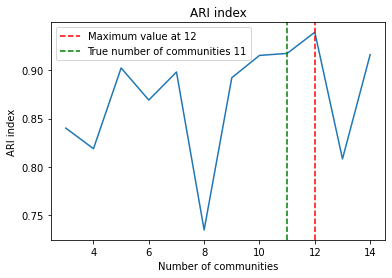

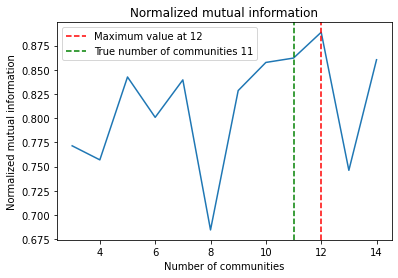

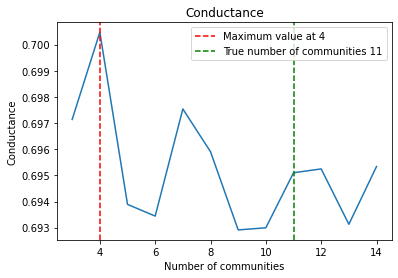

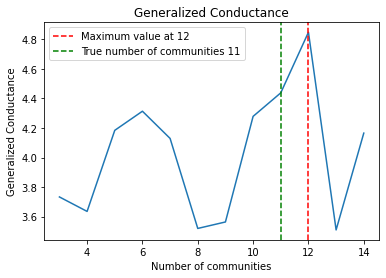

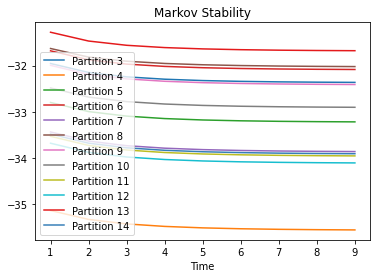

In [10]:
empirical_analysis_project(primary_school, true_partition_primary_school,
                           true_matrix_primary_school, min_number, max_number, K,n_community)

## High school


In [11]:
file_path_high_school = data_path + \
    "contact-high-school-classes/hyperedges-contact-high-school-classes.txt"
file_true_partition_high_school = data_path + \
    "contact-high-school-classes/node-labels-contact-high-school-classes.txt"

true_partition_high_school, true_matrix_high_school = import_txt_true_one_community(
    file_true_partition_high_school)
high_school = import_txt_comma_hypergraph(file_path_high_school)

n_community = true_matrix_high_school.shape[1]
print("True number of communities high school: ",n_community
      )

True number of communities high school:  9


In [12]:
min_number, max_number = 3, 14

The number of nodes is 327


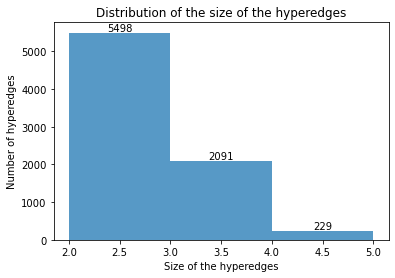

<Figure size 432x288 with 0 Axes>

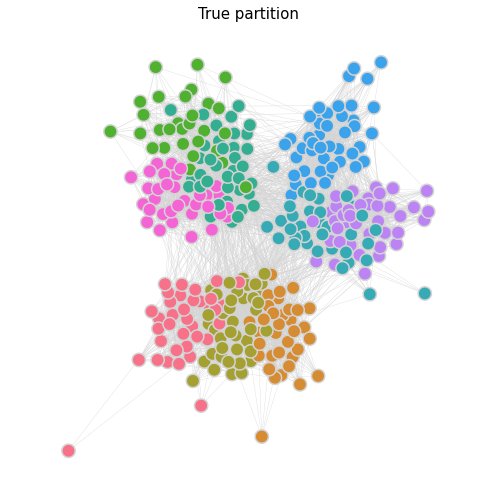

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


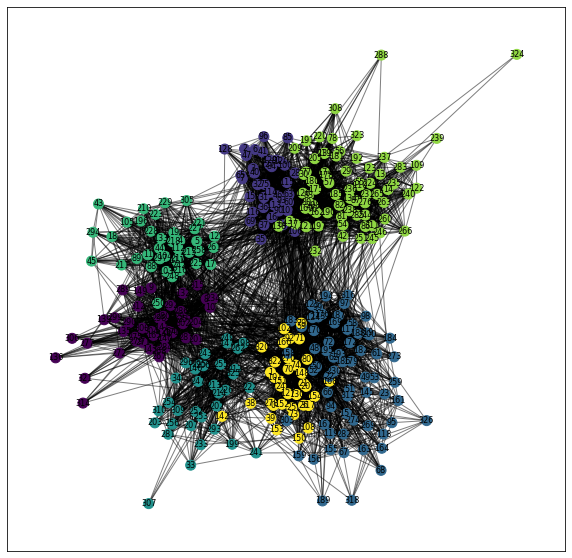

Adjusted Rand Index (ARI): 0.7952415821237442
Normalized Mutual Information (NMI): 0.7381926019074355
Conductance: 0.27666734041625346
Generalized Conductance: 0.64338778939471


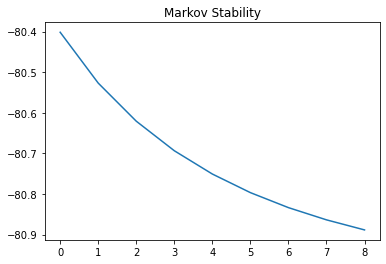

Number of partitions of K -clique reduction:  7
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.902349083207053
Normalized Mutual Information (NMI): 0.8850597303983597
Conductance: 0.2912792994177881
Generalized Conductance: 1.3079281142863195


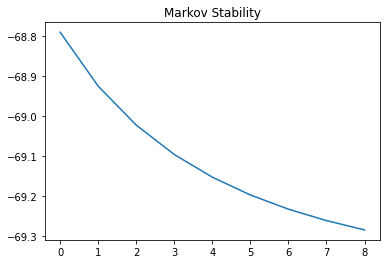

Number of partitions of K -clique reduction weighting the hyperedges:  8
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.9933829345386087
Normalized Mutual Information (NMI): 0.9889869526275193
Conductance: 0.3186284302562185
Generalized Conductance: 1.3902074721693165
Number of partitions:  9
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 1.0
Normalized Mutual Information (NMI): 1.0
Conductance: 0.31609590966605783
Generalized Conductance: 1.4228277365504574
Number of partitions:  9
-----------------------------------------------------------------------------------
Spectral clustering with number of community find with modularity
-----

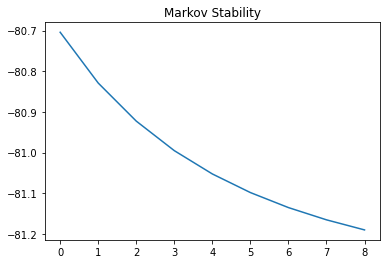

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8032200936709264
Normalized Mutual Information (NMI): 0.7497042082847416
Conductance: 0.2896226590815285
Generalized Conductance: 1.3769222980631228


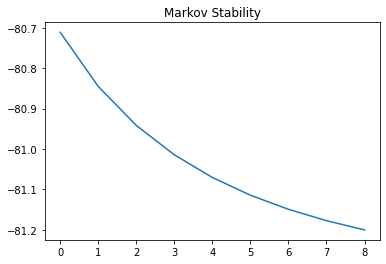

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


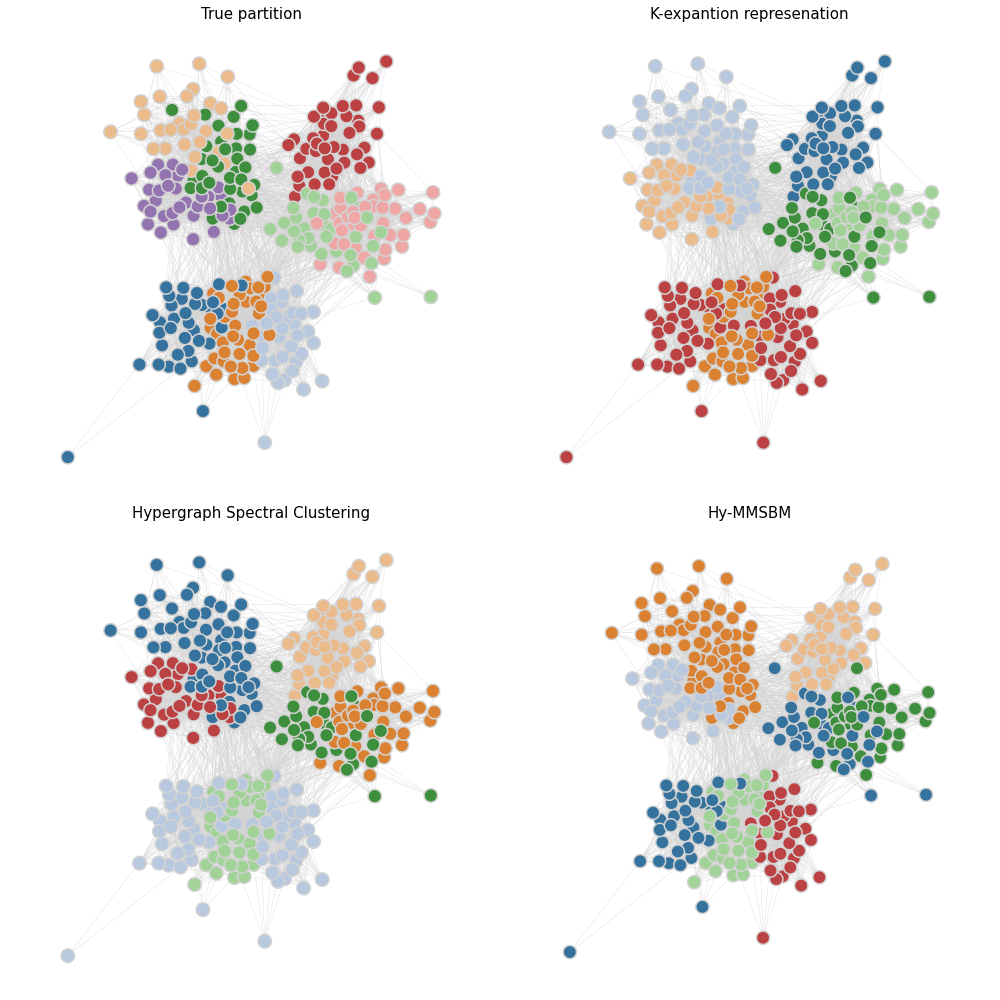

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.9866719641768288
Normalized Mutual Information (NMI): 0.9779805155411886
Conductance: 0.31976456706924045
Generalized Conductance: 1.2634477237769883


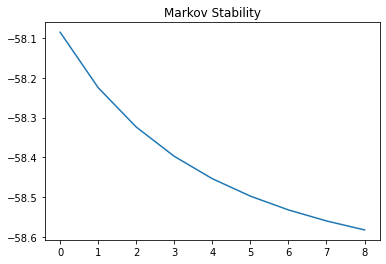

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.9751210739998792
Normalized Mutual Information (NMI): 0.9646280919291061
Conductance: 0.3240871227491131
Generalized Conductance: 1.458648579879025


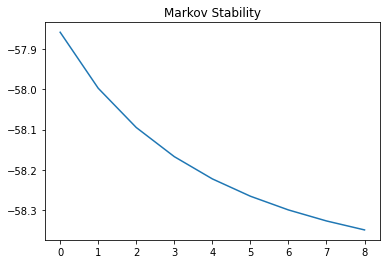

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


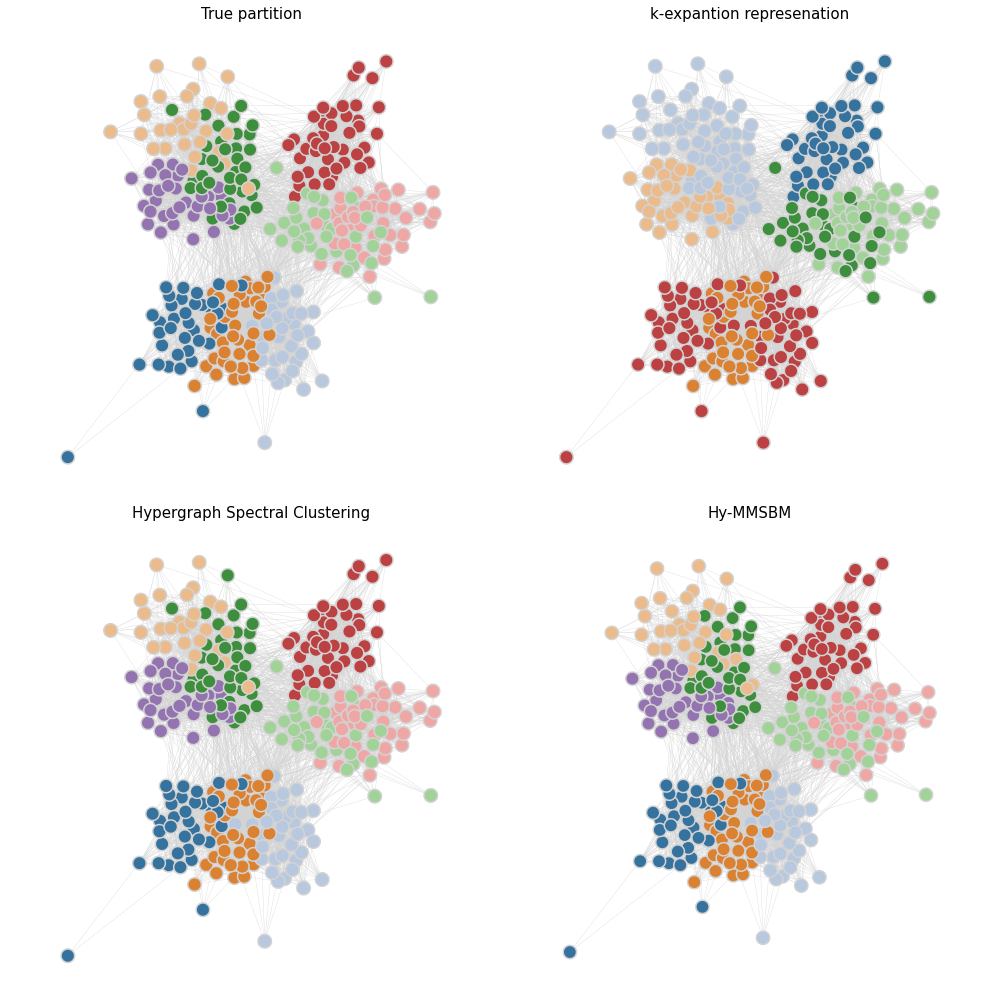

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


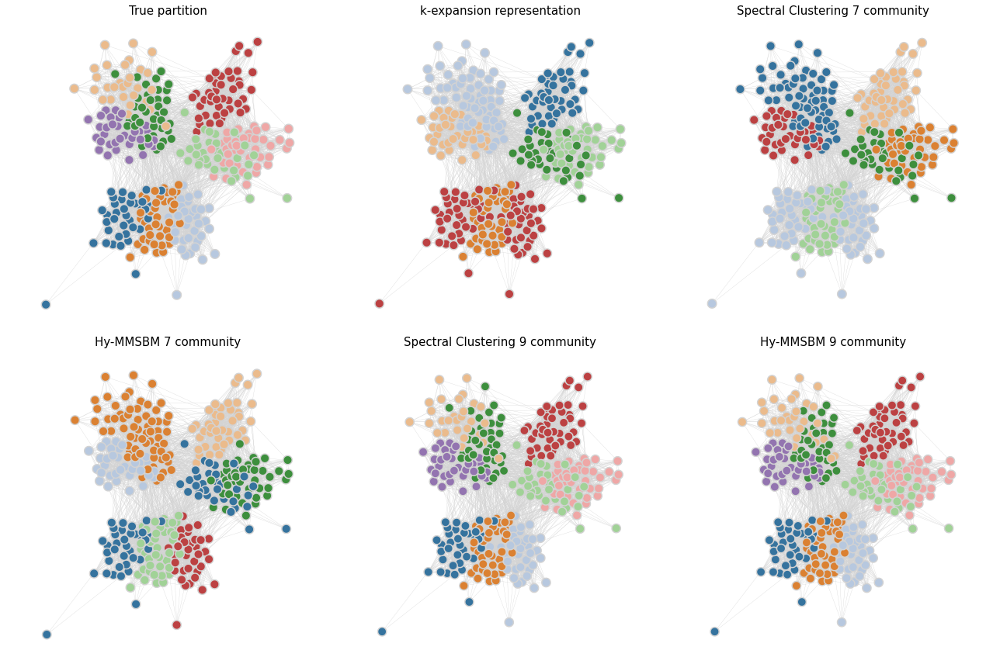

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  3
Adjusted Rand Index (ARI): 0.37317292021062043
Normalized Mutual Information (NMI): 0.2624217562980404
Conductance: 0.13292168346024305
Generalized Conductance: 0.22182280076755234
Number of communities:  4
Adjusted Rand Index (ARI): 0.42897309139756873
Normalized Mutual Information (NMI): 0.41474385007173226
Conductance: 0.18159609317691788
Generalized Conductance: 0.35811993840223233
Number of communities:  5
Adjusted Rand Index (ARI): 0.5456982742874473
Normalized Mutual Information (NMI): 0.528584559891675
Conductance: 0.21036036050098988
Generalized Conductance: 0.4529436012789564
Number of communities:  6
Adjusted Rand Index (ARI): 0.6678938008588837
Normalized Mutual Information (NMI): 0.6429511410305886
Conductance: 0.2474871365881727
Generalized Conductan

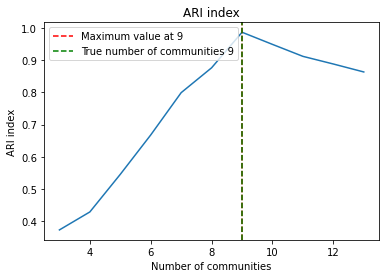

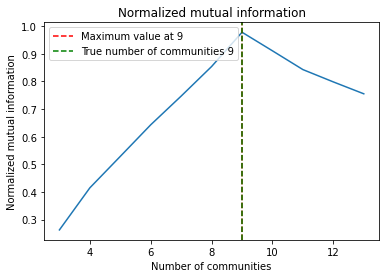

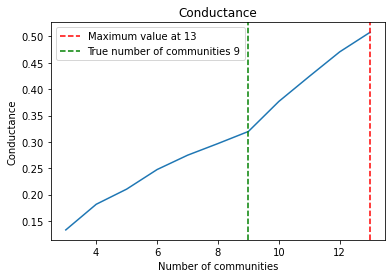

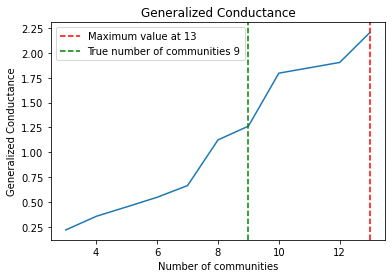

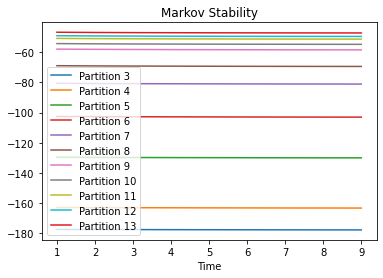

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.9715775930932469
Normalized Mutual Information (NMI): 0.9584223869167139
Conductance: 0.32478564632353096
Generalized Conductance: 1.266842704506285
Adjusted Rand Index (ARI): 0.9844538115917038
Normalized Mutual Information (NMI): 0.9804080590342795
Conductance: 0.3192929569739608
Generalized Conductance: 1.4311685580001405
Adjusted Rand Index (ARI): 0.9801220301870632
Normalized Mutual Information (NMI): 0.9682411712642679
Conductance: 0.322251988717636
Generalized Conductance: 1.4017460305557419
Adjusted Rand Index (ARI): 0.9930014312738938
Normalized Mutual Information (NMI): 0.9888854106231448
Conductance: 0.3191240752452854
Generalized Conductance: 1.4303427537161955
Adjusted Rand Index (ARI): 0.9577378106641072
Normalized Mutual Information (NMI): 0.9442716021959039

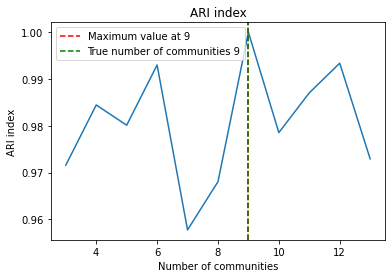

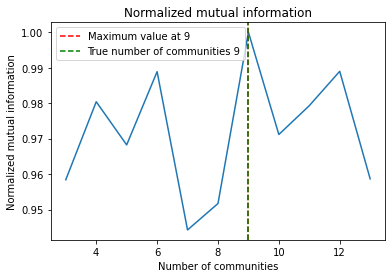

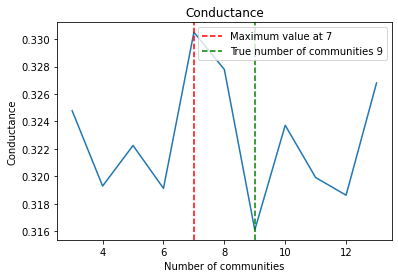

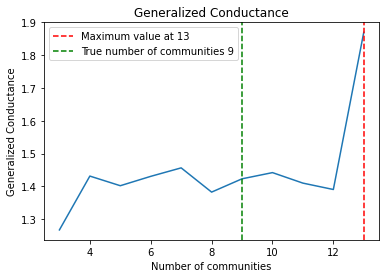

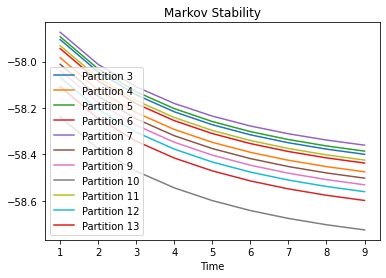

In [13]:
empirical_analysis_project(high_school, true_partition_high_school,
                           true_matrix_high_school, min_number, max_number, n_community,n_community)

## Workspace


In [14]:
file_path_workspace = '../data/workspace/workspace1.npz'
file_path_ground_truth_workspace = '../data/workspace/workspace1_meta.csv'
hyperedges_workspace = import_from_npz(file_path_workspace)

In [15]:
data = pd.read_csv(file_path_ground_truth_workspace)
true_community = {}
true_matrix = {}
for i in range(len(data)):
    if data['classID'][i] not in true_community:
        true_community[data['classID'][i]] = []
    true_community[data['classID'][i]].append(data['nodeID'][i])
    true_matrix[data['nodeID'][i]] = data['classID'][i]

number_community = len(true_community)
matrix = np.zeros((len(true_matrix), number_community))
for i in range(len(true_matrix)):
    matrix[i][true_matrix[i]-1] = 1

true_partition_workspace = true_community
true_matrix_workspace = matrix

In [16]:
number_community = true_matrix_workspace.shape[1]
print("True number of communities workspace: ", number_community)
min_number = 2
max_number = 8

True number of communities workspace:  5


The number of nodes is 92


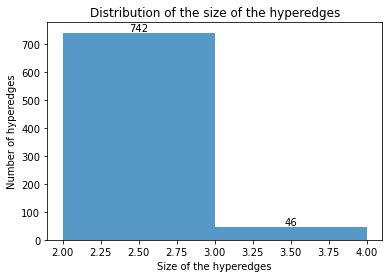

<Figure size 432x288 with 0 Axes>

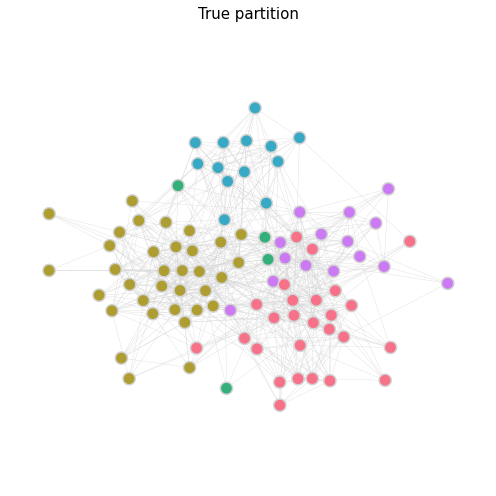

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


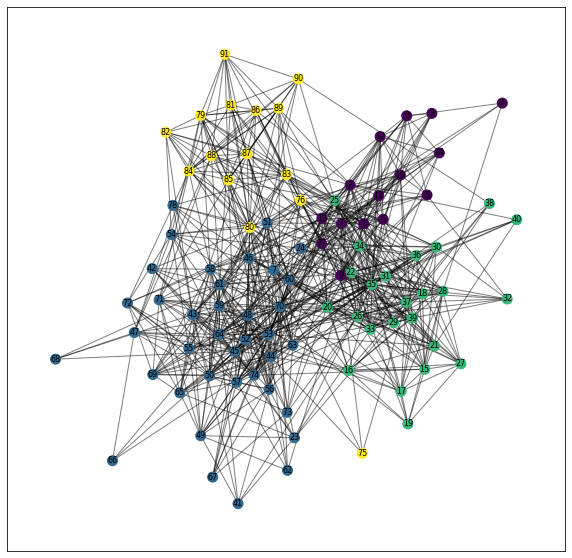

Adjusted Rand Index (ARI): 0.849997847055393
Normalized Mutual Information (NMI): 0.7470958766764417
Conductance: 0.3503175087945525
Generalized Conductance: 1.4022848625573205


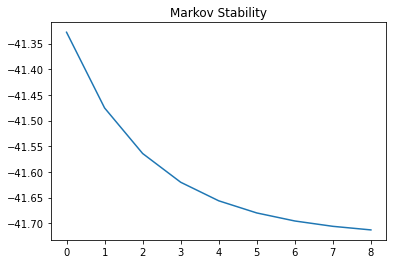

Number of partitions of K -clique reduction:  4
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8998028177647912
Normalized Mutual Information (NMI): 0.7806677749066437
Conductance: 0.3495273957856497
Generalized Conductance: 0.9604181702374786


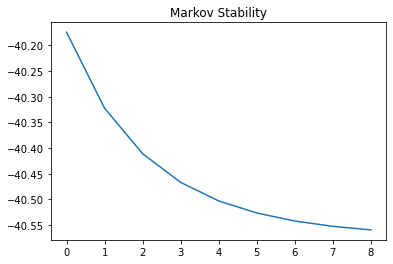

Number of partitions of K -clique reduction weighting the hyperedges:  4
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.44447166721792786
Normalized Mutual Information (NMI): 0.4343875909792467
Conductance: 0.6739909308451832
Generalized Conductance: 1.7460856141138712
Number of partitions:  11
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.48148326821884707
Normalized Mutual Information (NMI): 0.4048002244873714
Conductance: 0.7114267671271702
Generalized Conductance: 2.053432643392974
Number of partitions:  12
-----------------------------------------------------------------------------------
Spectral clustering with number of comm

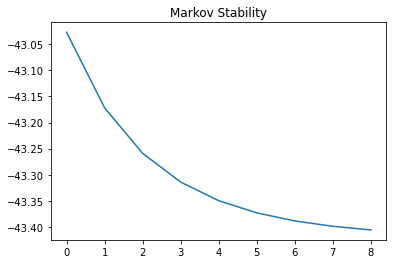

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.8600617380669922
Normalized Mutual Information (NMI): 0.7491940904507922
Conductance: 0.35099034898242687
Generalized Conductance: 2.238787287001347


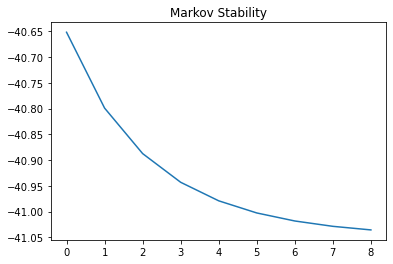

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


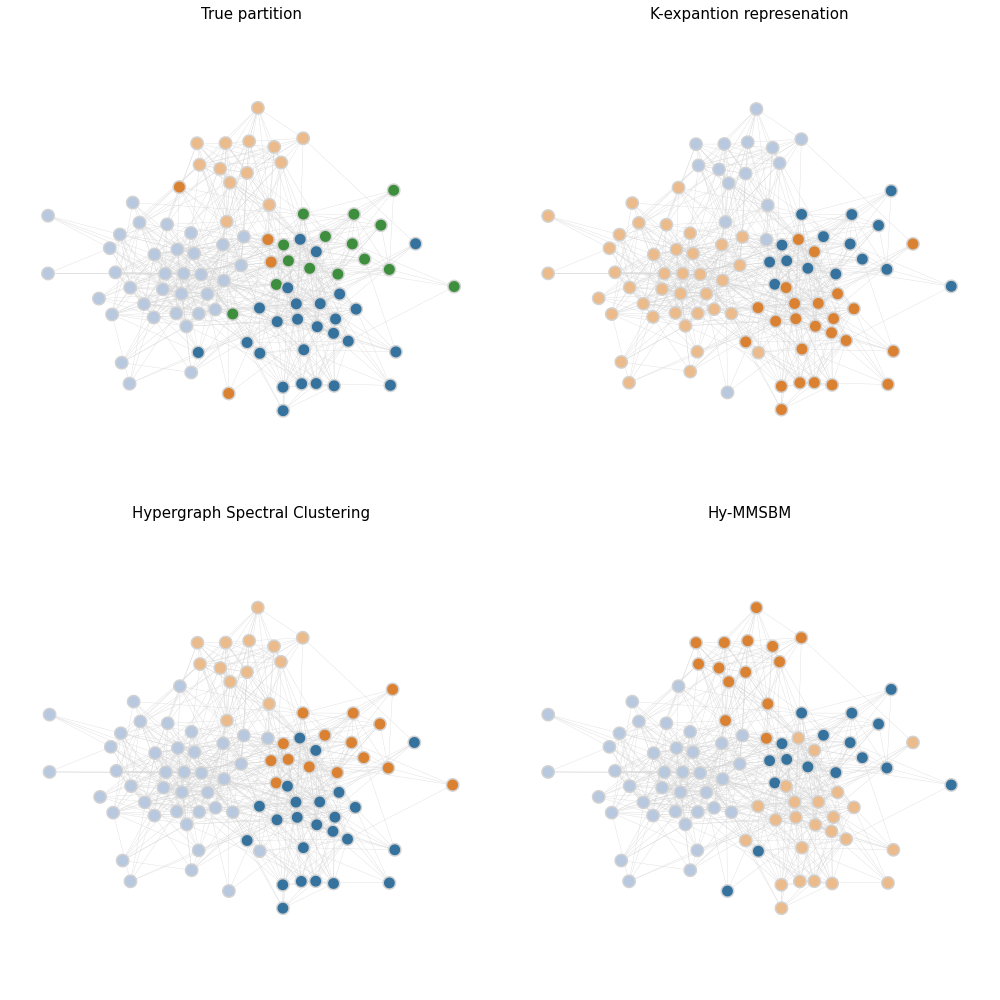

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.794789340131202
Normalized Mutual Information (NMI): 0.7008494590651632
Conductance: 0.43382926382710385
Generalized Conductance: 1.4677904970570403


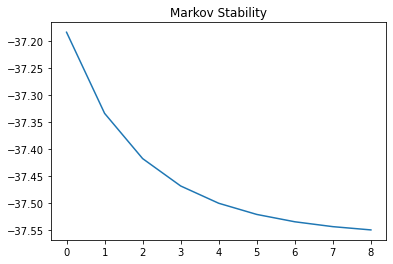

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.6564665320232745
Normalized Mutual Information (NMI): 0.5828829190801605
Conductance: 0.46127210948118674
Generalized Conductance: 2.457264166699544


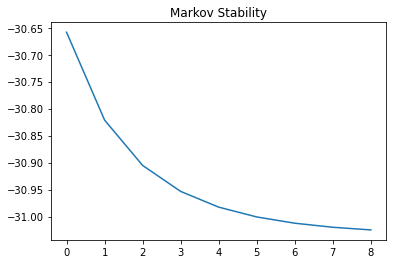

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


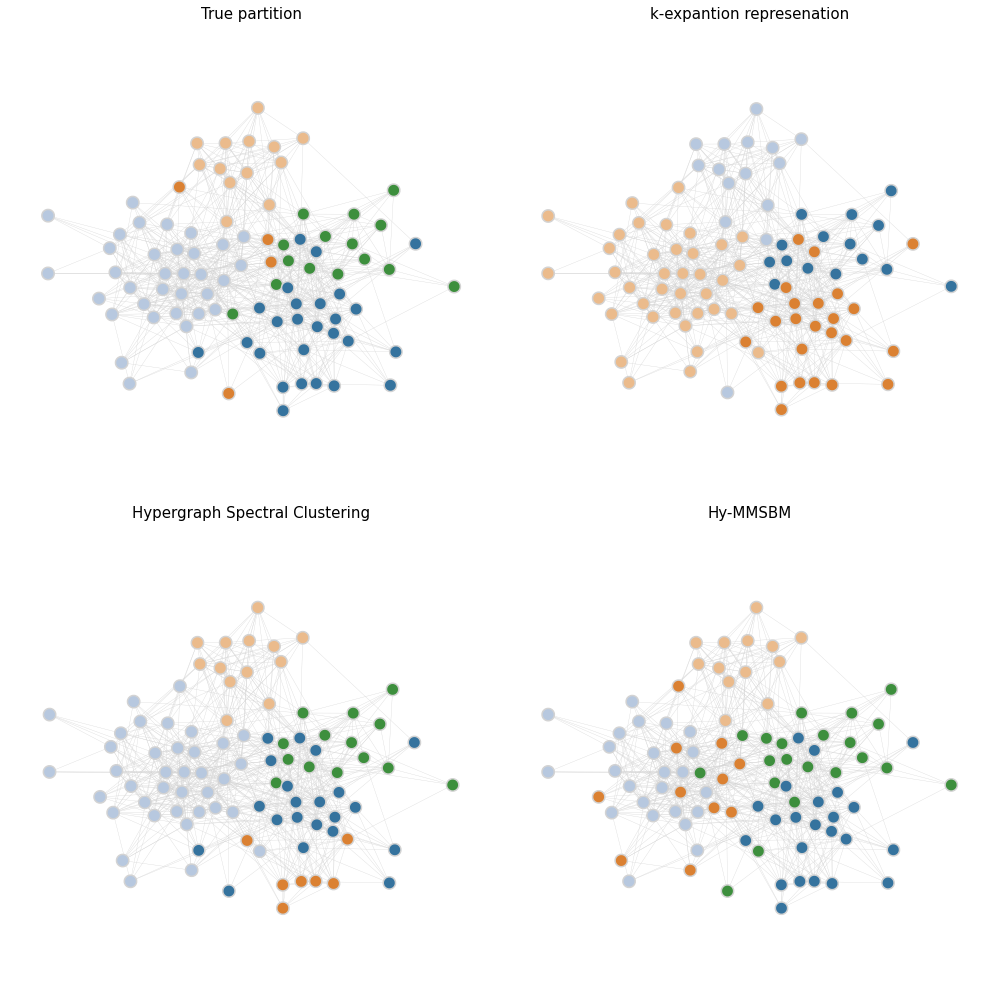

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


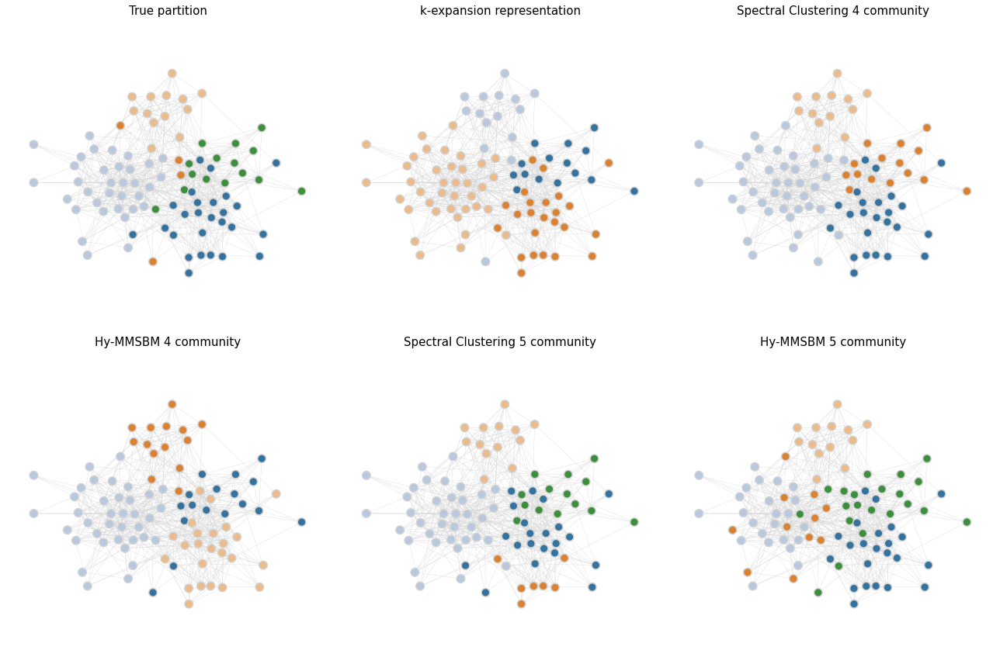

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): 0.46887639019973903
Normalized Mutual Information (NMI): 0.2841785796059393
Conductance: 0.21739130434782608
Generalized Conductance: 0.9717659963372294
Number of communities:  3
Adjusted Rand Index (ARI): 0.6691177473985321
Normalized Mutual Information (NMI): 0.5432634951366029
Conductance: 0.28116508569387966
Generalized Conductance: 0.9884486075557466
Number of communities:  4
Adjusted Rand Index (ARI): 0.824752646971458
Normalized Mutual Information (NMI): 0.7575468773478778
Conductance: 0.34667806387840094
Generalized Conductance: 1.44021814723915
Number of communities:  5
Adjusted Rand Index (ARI): 0.794789340131202
Normalized Mutual Information (NMI): 0.7008494590651632
Conductance: 0.43382926382710385
Generalized Conductance: 1.

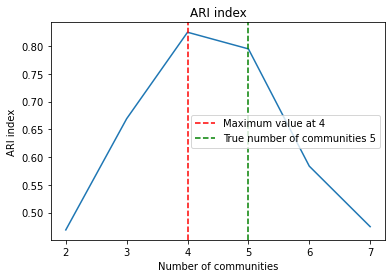

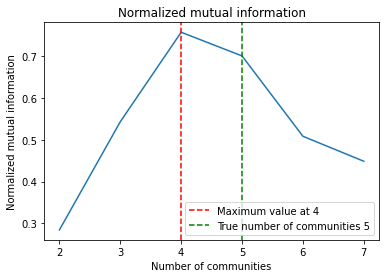

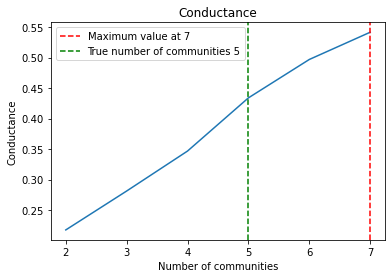

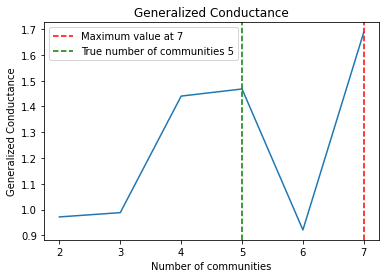

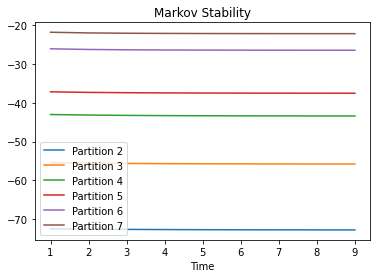

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.7120991431932452
Normalized Mutual Information (NMI): 0.6116487435886734
Conductance: 0.4499532020777182
Generalized Conductance: 2.868655452565469
Adjusted Rand Index (ARI): 0.6286618892550173
Normalized Mutual Information (NMI): 0.5387155631999683
Conductance: 0.45342970459607734
Generalized Conductance: 2.311825883054144
Adjusted Rand Index (ARI): 0.6578061497770252
Normalized Mutual Information (NMI): 0.5928440635261399
Conductance: 0.44089318264039584
Generalized Conductance: 1.7222273609371974
Adjusted Rand Index (ARI): 0.7277764233743794
Normalized Mutual Information (NMI): 0.6209600736333561
Conductance: 0.4663810214627083
Generalized Conductance: 2.2964701454071594
Adjusted Rand Index (ARI): 0.6933354025951242
Normalized Mutual Information (NMI): 0.607212106794471

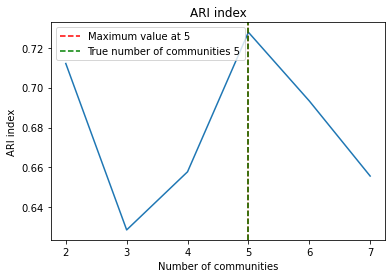

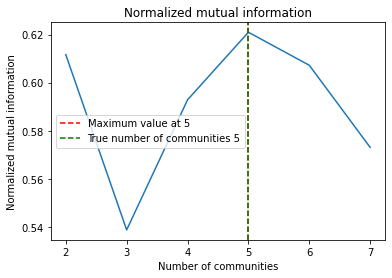

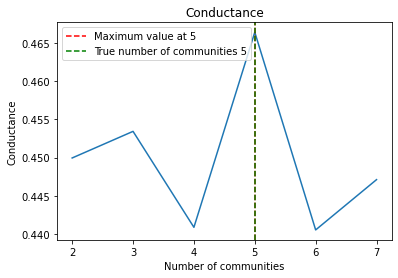

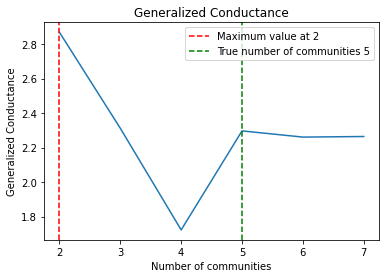

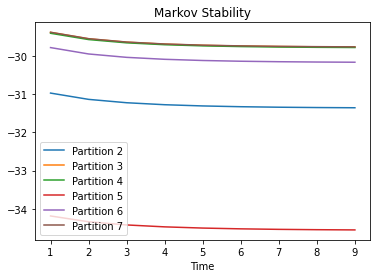

In [17]:
empirical_analysis_project(hyperedges_workspace, true_partition_workspace,
                           true_matrix_workspace, min_number, max_number, number_community,number_community)

### Senate Commities


In [18]:
file_path_senate_committees = data_path + \
    "senate-committees/hyperedges-senate-committees.txt"

file_true_partition_senate_committees_old = data_path + \
    "senate-committees/node-labels-senate-committees.txt"
file_true_partition_senate_committees = data_path + \
    "senate-committees/node-labels-senate-committees_new.txt"

with open(file_true_partition_senate_committees_old, "r", encoding="utf-8") as file:
    content = file.read()

# Replace '਱' with '0' and 'ਲ' with '1'
binary_content = content.replace("਱", "0").replace("ਲ", "1")

# Write the binary output to a new file
with open(file_true_partition_senate_committees, "w", encoding="utf-8") as file:
    file.write(binary_content)


true_partition_senate_committees, true_matrix_senate_committees = import_txt_true_one_community(
    file_true_partition_senate_committees)
senate_committees = import_txt_comma_hypergraph(file_path_senate_committees)

print("True number of communities senate committiees: ",
      true_matrix_senate_committees.shape[1])
number_community = true_matrix_senate_committees.shape[1]

True number of communities senate committiees:  2


In [19]:
min_number, max_number = 2,  7

The number of nodes is 282


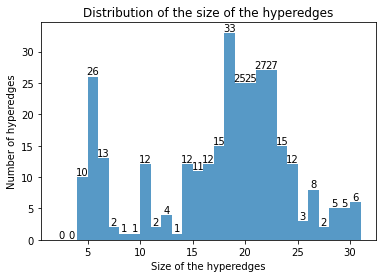

<Figure size 432x288 with 0 Axes>

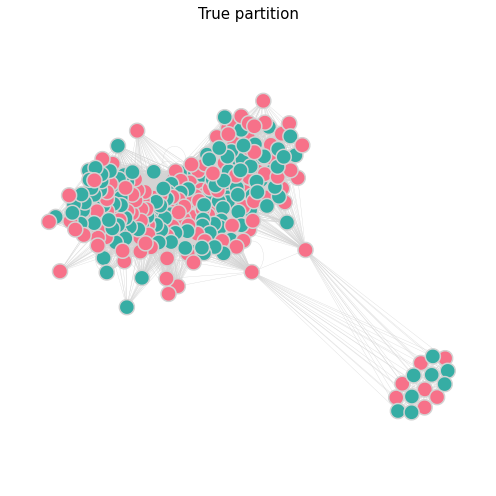

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


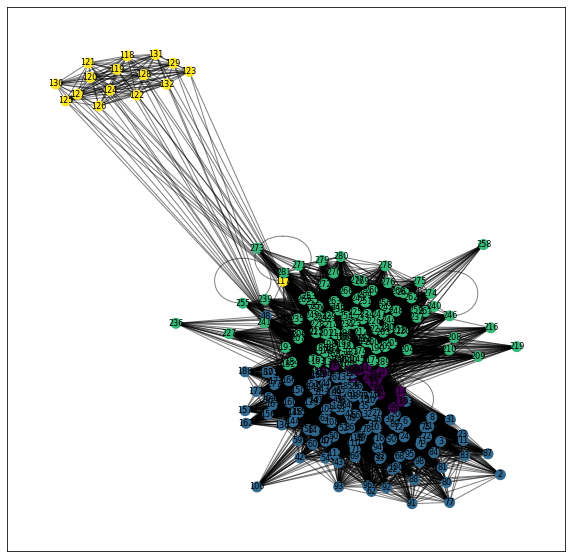

Adjusted Rand Index (ARI): -0.0032573801295609508
Normalized Mutual Information (NMI): 0.000619295199173115
Conductance: 0.44331947527484084
Generalized Conductance: 85.03493609110305


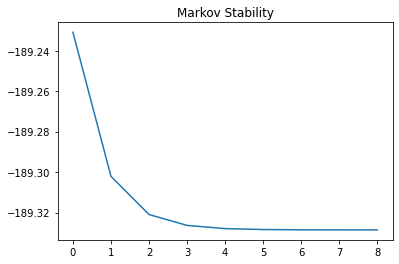

Number of partitions of K -clique reduction:  4
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.004556987527968671
Normalized Mutual Information (NMI): 0.0004991240204201045
Conductance: 0.5488511437652002
Generalized Conductance: 83.8561000801033


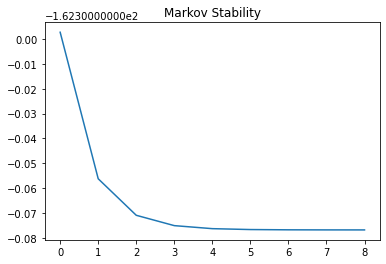

Number of partitions of K -clique reduction weighting the hyperedges:  5
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.002764192309096743
Normalized Mutual Information (NMI): 0.0023832281705509265
Conductance: 0.676627383853875
Generalized Conductance: 126.61143783262014
Number of partitions:  8
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0037119047290547053
Normalized Mutual Information (NMI): 0.0018685926433212375
Conductance: 0.7006325139826148
Generalized Conductance: 150.755924301618
Number of partitions:  8
-----------------------------------------------------------------------------------
Spectral clustering with number 

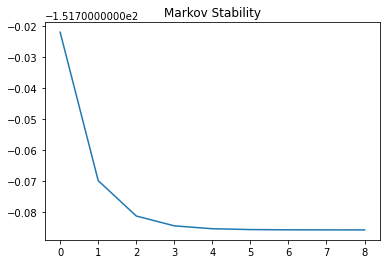

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0031806713821797123
Normalized Mutual Information (NMI): 0.004076729690666939
Conductance: 0.6926365748026679
Generalized Conductance: 100.49002837581187


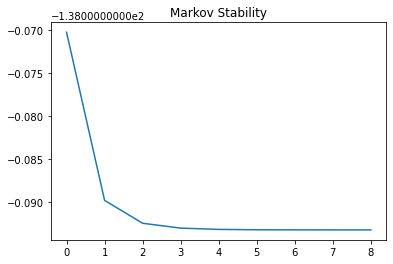

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


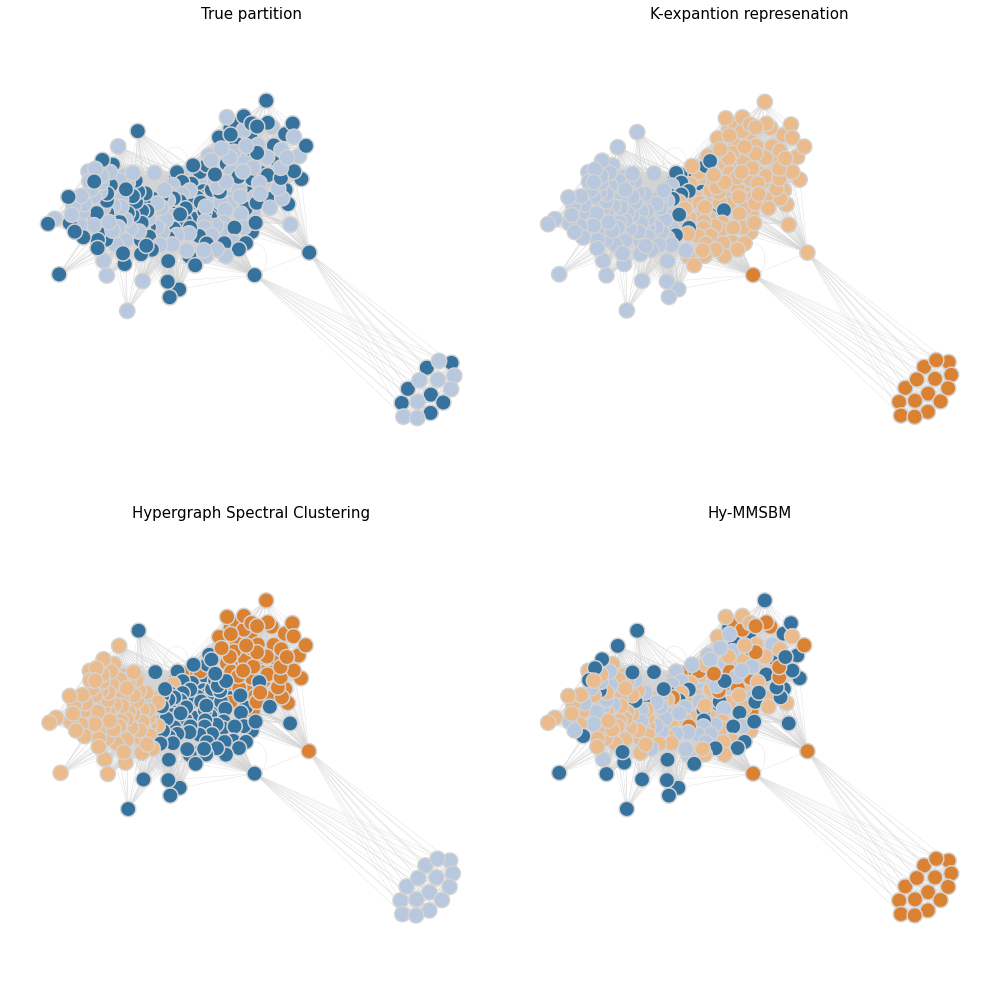

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0007576030294211492
Normalized Mutual Information (NMI): 0.00014395996521765825
Conductance: 0.125
Generalized Conductance: 0.23774513596270708


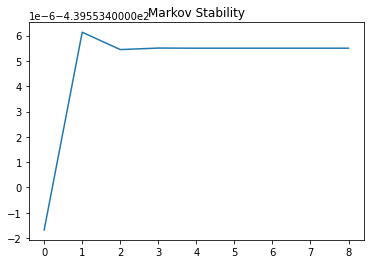

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0019563892705794133
Normalized Mutual Information (NMI): 0.005472312878601252
Conductance: 0.825089605734767
Generalized Conductance: 79.76352179450308


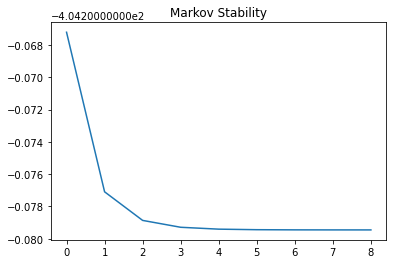

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


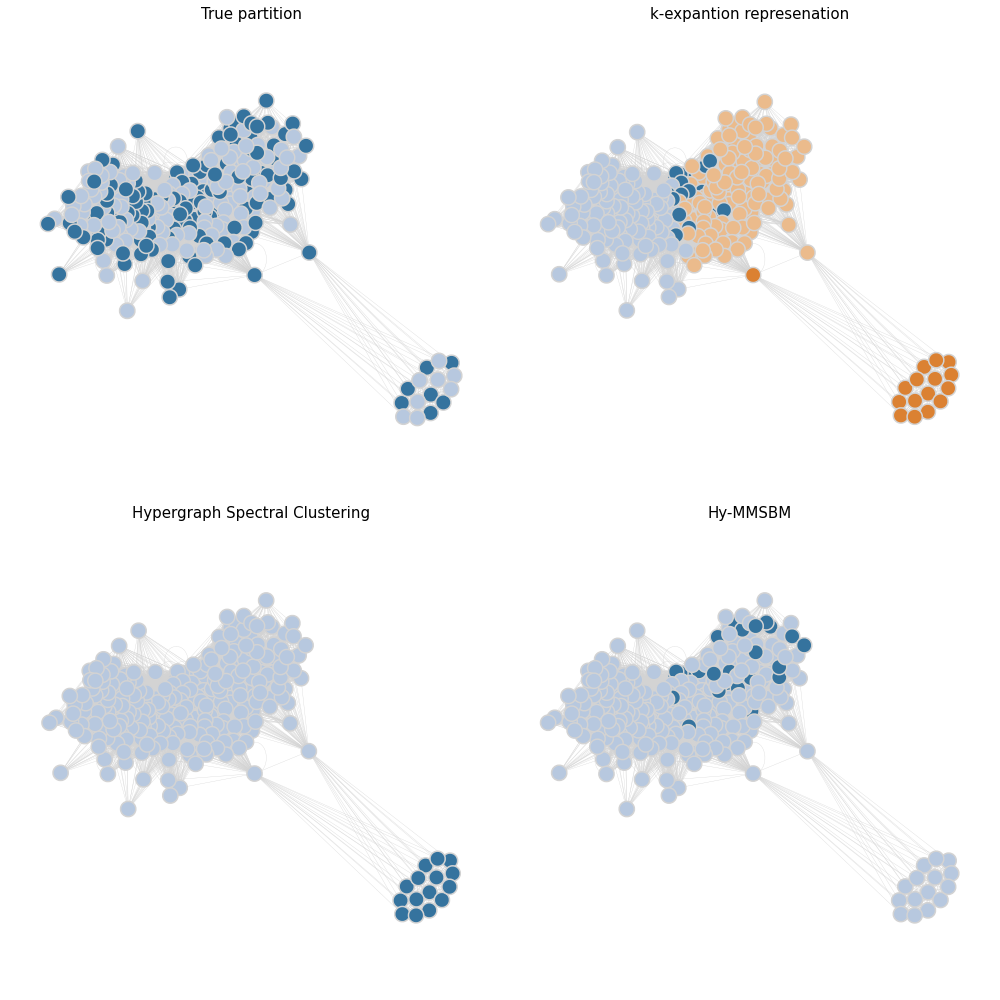

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


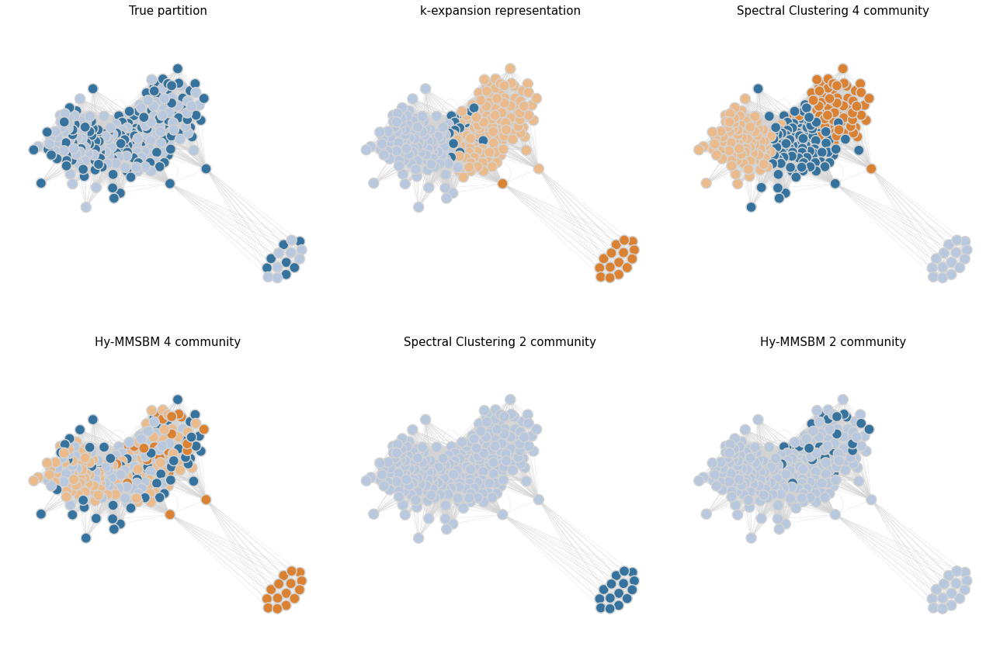

-----------------------------------------------------------------------------------
Different assortative
-----------------------------------------------------------------------------------


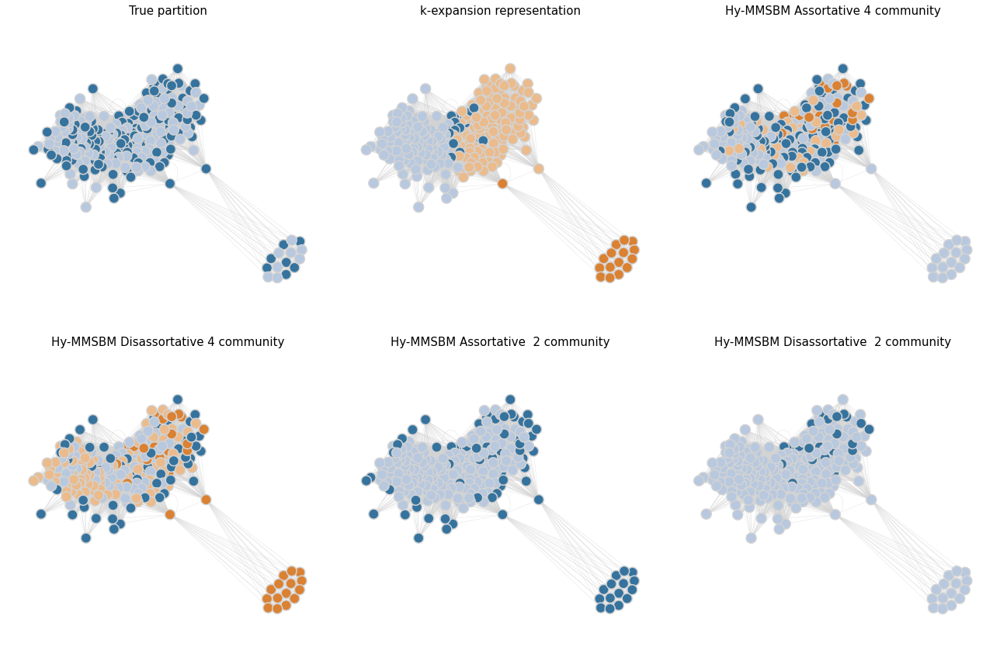

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -0.0007576030294211492
Normalized Mutual Information (NMI): 0.00014395996521765825
Conductance: 0.125
Generalized Conductance: 0.23774513596270708
Number of communities:  3
Adjusted Rand Index (ARI): -0.0023597130834784
Normalized Mutual Information (NMI): 0.0010542725728425147
Conductance: 0.23835520099332327
Generalized Conductance: 26.880765536318265
Number of communities:  4
Adjusted Rand Index (ARI): -0.004708403632658981
Normalized Mutual Information (NMI): 0.00016139739752960252
Conductance: 0.36190729910692176
Generalized Conductance: 53.825661267009416
Number of communities:  5
Adjusted Rand Index (ARI): -0.0033060031337013673
Normalized Mutual Information (NMI): 0.0015188907727733245
Conductance: 0.4820206157357367
Generalized 

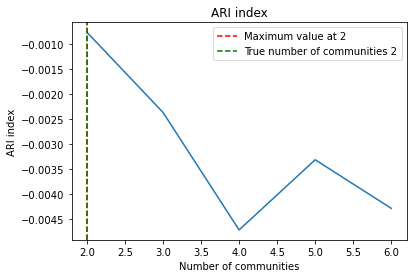

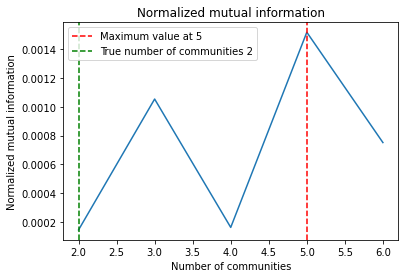

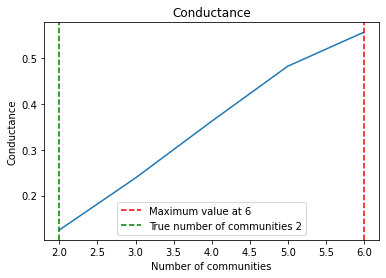

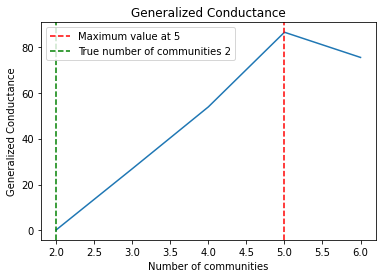

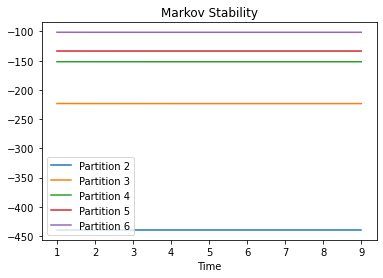

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0021801710472544155
Normalized Mutual Information (NMI): 0.0047804427690662015
Conductance: 0.7515605493133583
Generalized Conductance: 79.39441573831651
Adjusted Rand Index (ARI): 0.017733607266346763
Normalized Mutual Information (NMI): 0.020469484476110154
Conductance: 0.78894251864853
Generalized Conductance: 78.2903311058298
Adjusted Rand Index (ARI): 0.019379209452383365
Normalized Mutual Information (NMI): 0.01931059935385778
Conductance: 0.7409493161705552
Generalized Conductance: 77.6259900087349
Adjusted Rand Index (ARI): 0.003385586934739497
Normalized Mutual Information (NMI): 0.00688416659053127
Conductance: 0.8232244686365993
Generalized Conductance: 60.20028008971366
Adjusted Rand Index (ARI): -0.0009274381951595571
Normalized Mutual Information (NMI): 0.001

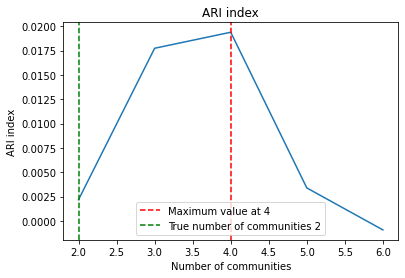

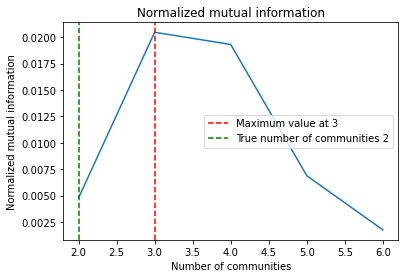

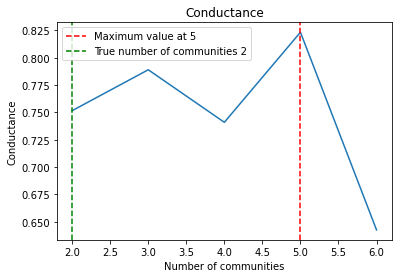

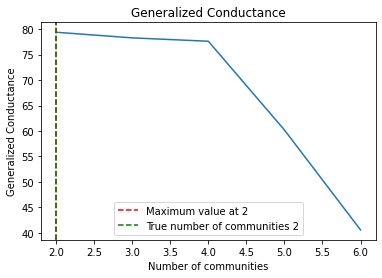

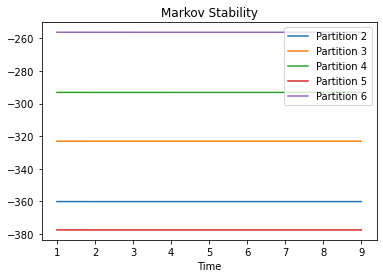

In [20]:
empirical_analysis_project(senate_committees, true_partition_senate_committees,
                           true_matrix_senate_committees, min_number, max_number, true_matrix_senate_committees.shape[1],number_community,assortative=False)

The number of nodes is 282


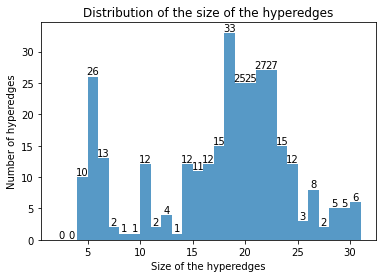

<Figure size 432x288 with 0 Axes>

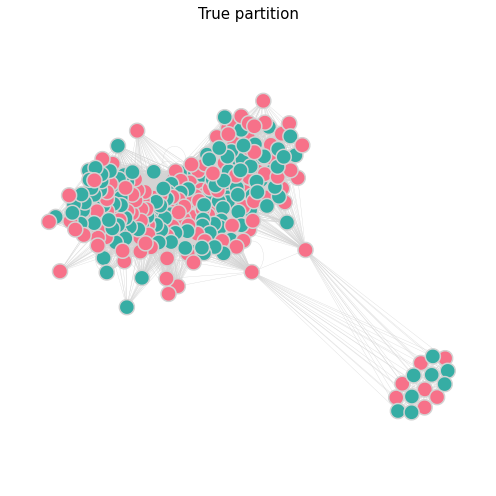

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


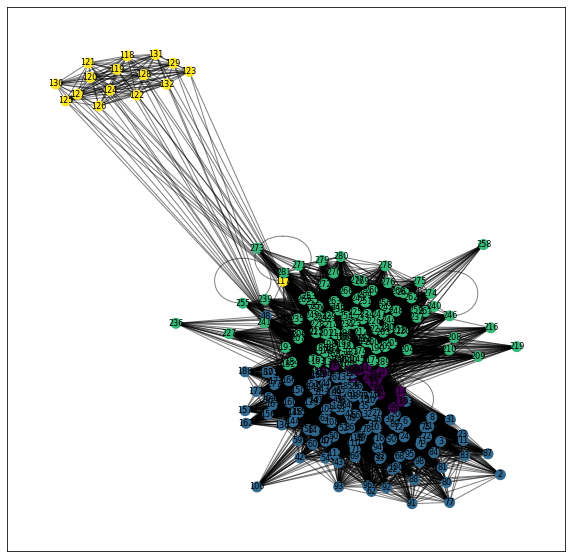

Adjusted Rand Index (ARI): -0.0032573801295609508
Normalized Mutual Information (NMI): 0.000619295199173115
Conductance: 0.44331947527484084
Generalized Conductance: 85.03493609110305


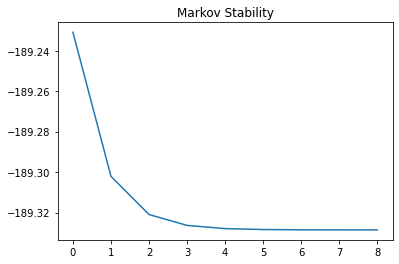

Number of partitions of K -clique reduction:  4
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.004556987527968671
Normalized Mutual Information (NMI): 0.0004991240204201045
Conductance: 0.5488511437652002
Generalized Conductance: 83.8561000801033


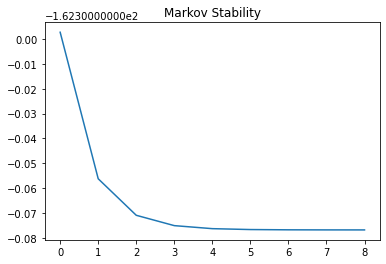

Number of partitions of K -clique reduction weighting the hyperedges:  5
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.002764192309096743
Normalized Mutual Information (NMI): 0.0023832281705509265
Conductance: 0.676627383853875
Generalized Conductance: 126.61143783262014
Number of partitions:  8
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0037119047290547053
Normalized Mutual Information (NMI): 0.0018685926433212375
Conductance: 0.7006325139826148
Generalized Conductance: 150.755924301618
Number of partitions:  8
-----------------------------------------------------------------------------------
Spectral clustering with number 

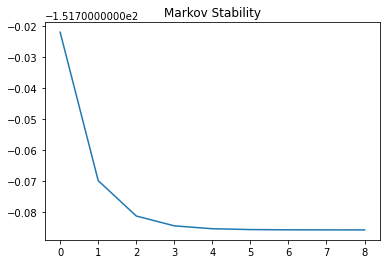

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.008301786543362987
Normalized Mutual Information (NMI): 0.006718960308134644
Conductance: 0.7049715701198008
Generalized Conductance: 86.85653697112981


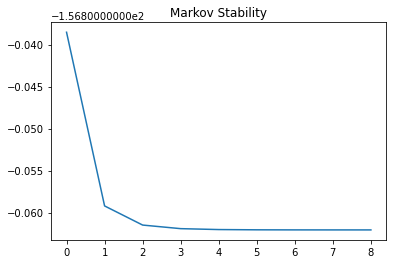

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


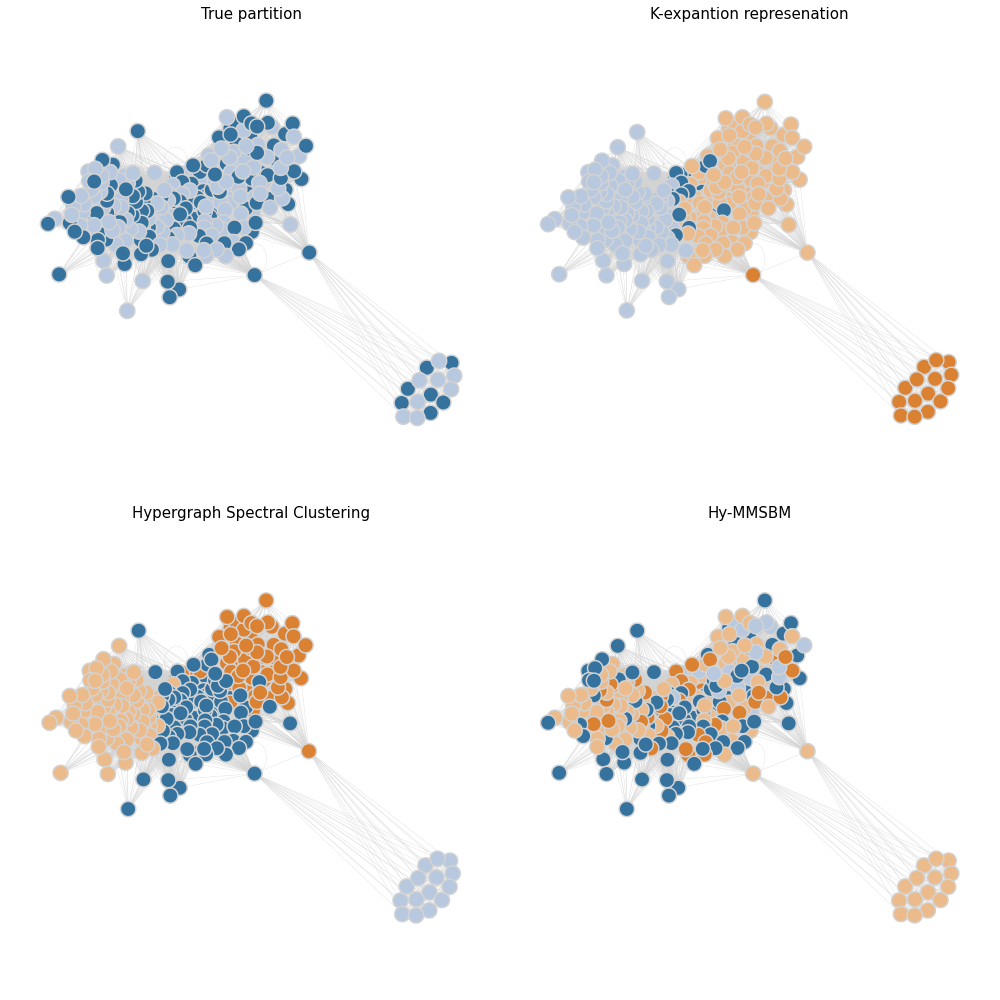

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0007576030294211492
Normalized Mutual Information (NMI): 0.00014395996521765825
Conductance: 0.125
Generalized Conductance: 0.23774513596270708


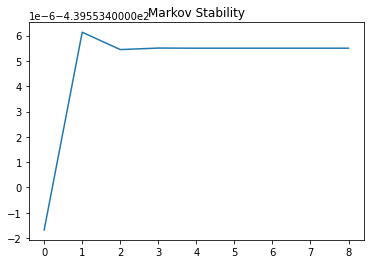

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0021801710472544155
Normalized Mutual Information (NMI): 0.0047804427690662015
Conductance: 0.7566909975669099
Generalized Conductance: 68.80218960392112


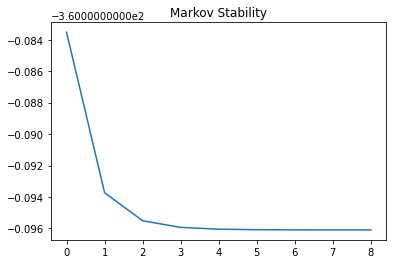

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


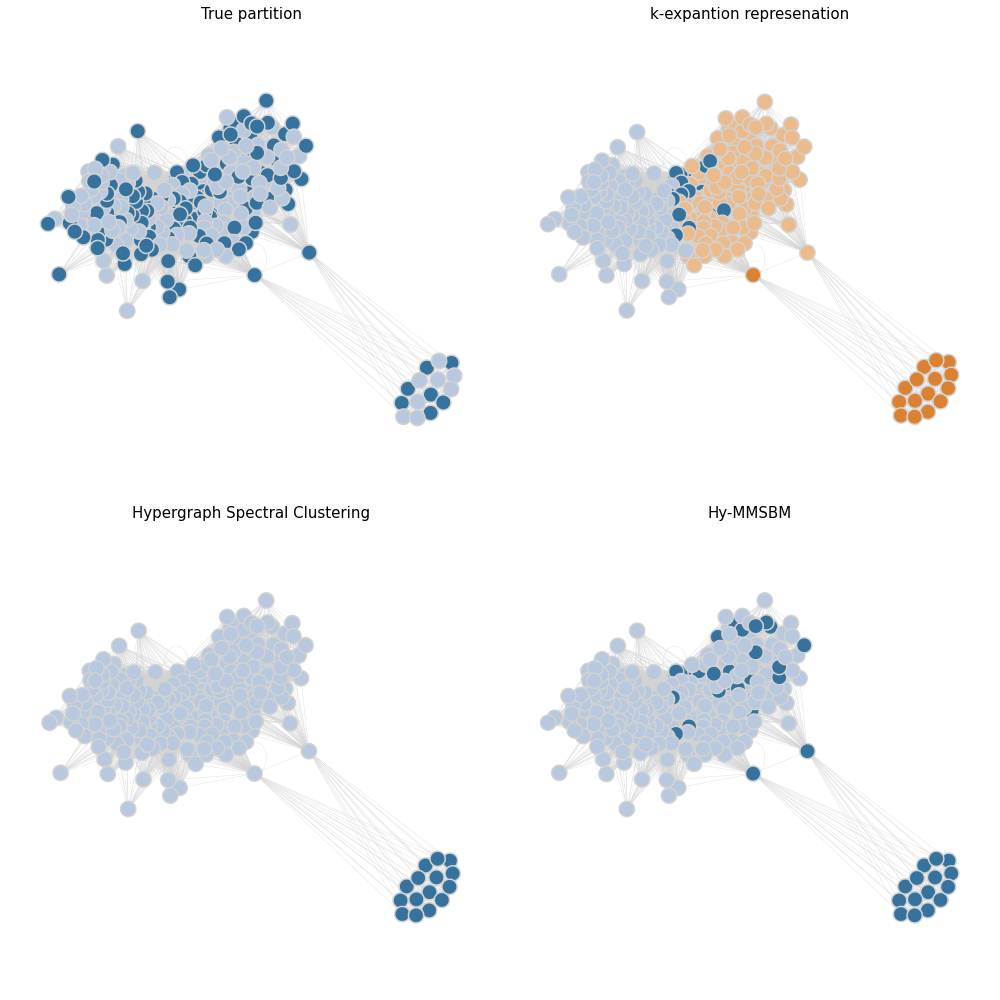

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


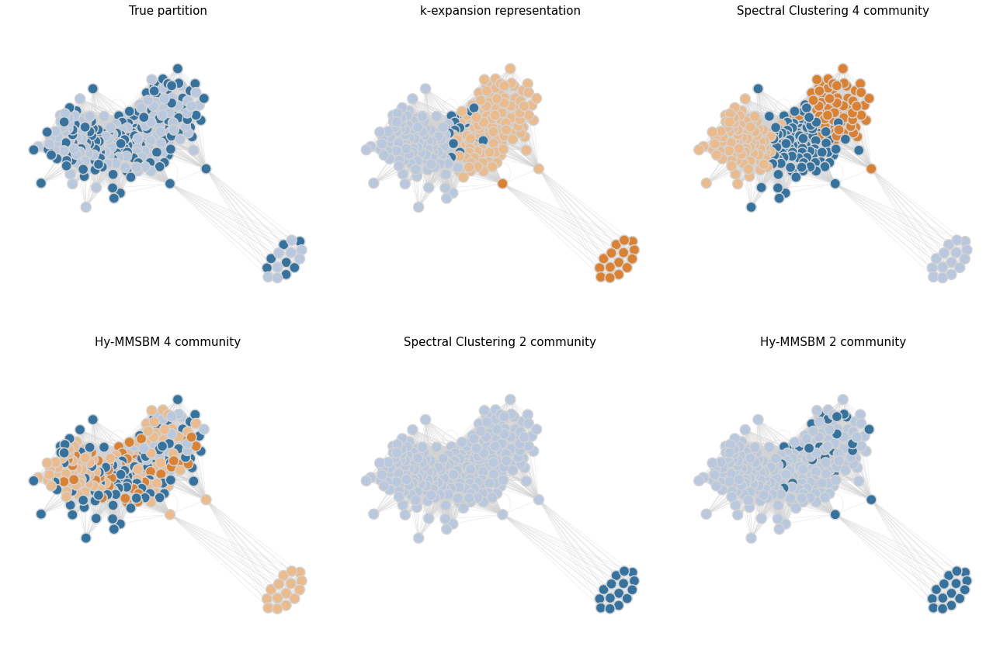

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -0.0007576030294211492
Normalized Mutual Information (NMI): 0.00014395996521765825
Conductance: 0.125
Generalized Conductance: 0.23774513596270708
Number of communities:  3
Adjusted Rand Index (ARI): -0.0023597130834784
Normalized Mutual Information (NMI): 0.0010542725728425147
Conductance: 0.23835520099332327
Generalized Conductance: 26.880765536318265
Number of communities:  4
Adjusted Rand Index (ARI): -0.004708403632658981
Normalized Mutual Information (NMI): 0.00016139739752960252
Conductance: 0.36190729910692176
Generalized Conductance: 53.825661267009416
Number of communities:  5
Adjusted Rand Index (ARI): -0.0033060031337013673
Normalized Mutual Information (NMI): 0.0015188907727733245
Conductance: 0.4820206157357367
Generalized 

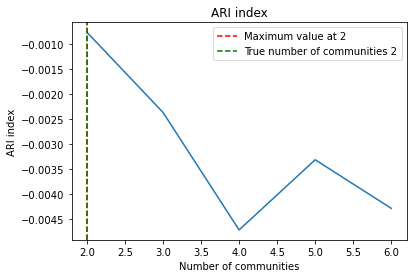

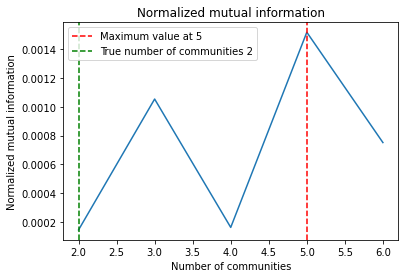

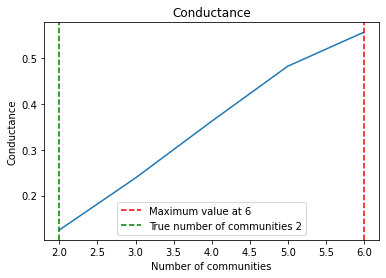

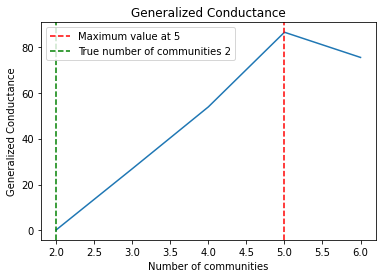

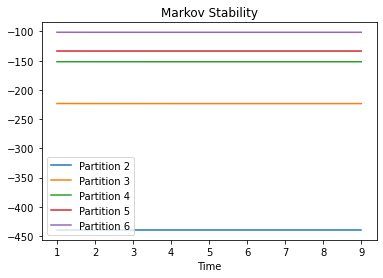

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.019379209452383365
Normalized Mutual Information (NMI): 0.01931059935385778
Conductance: 0.7409493161705552
Generalized Conductance: 77.6259900087349
Adjusted Rand Index (ARI): 0.0019563892705794133
Normalized Mutual Information (NMI): 0.005472312878601252
Conductance: 0.825089605734767
Generalized Conductance: 79.76352179450308
Adjusted Rand Index (ARI): 0.015179211165752726
Normalized Mutual Information (NMI): 0.014902329018581104
Conductance: 0.7314228590469843
Generalized Conductance: 52.539251040693124
Adjusted Rand Index (ARI): 0.0019563892705794133
Normalized Mutual Information (NMI): 0.005472312878601252
Conductance: 0.825089605734767
Generalized Conductance: 79.76352179450308
Adjusted Rand Index (ARI): 0.0021801710472544155
Normalized Mutual Information (NMI): 0.0

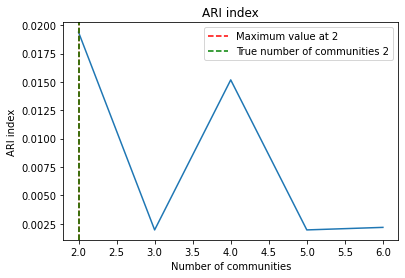

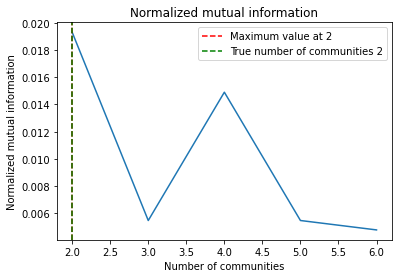

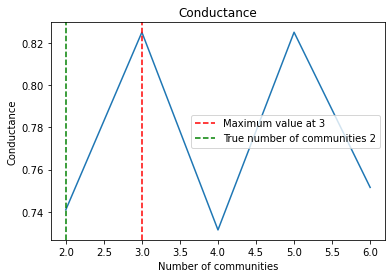

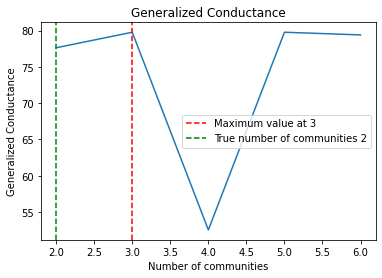

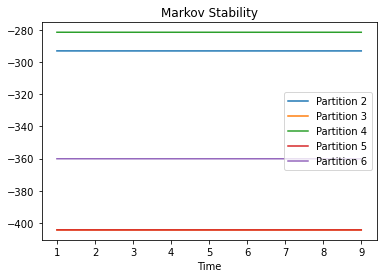

In [21]:
empirical_analysis_project(senate_committees, true_partition_senate_committees,
                           true_matrix_senate_committees, min_number, max_number, true_matrix_senate_committees.shape[1],number_community)

### Congress Committies


In [22]:
file_congress_committies = data_path + \
    "congress-committees/house_committees.csv"
data = pd.read_csv(file_congress_committies)

# Combine 'Column1' and 'Column2' into a new column 'Combined'
data['committeeID'] = data['committee'].astype(
    str) + data['session'].astype(str)

file_congress_committies_new = data_path + \
    "congress-committees/house_committees_new.csv"
# Save the DataFrame to CSV
data.to_csv(file_congress_committies_new, index=False)

In [23]:
import csv
from collections import defaultdict


committee_house = defaultdict(list)

with open(file_congress_committies_new, mode='r') as file:
    reader = csv.DictReader(file)
    for row in reader:
        committee = row['committeeID']
        senator_id = row['new_id']
        committee_house[committee].append(int(senator_id)-1)

# Convert dictionary values to a list of lists
committee_house_hyperedges = list(committee_house.values())

In [24]:
committee_house_hyperedges = [ x for x in committee_house_hyperedges if len(x) > 1]

In [25]:
true_community = {}
true_matrix = {}
for i in range(len(data)):
    if data['party'][i] not in true_community:
        true_community[data['party'][i]] = []
    true_community[data['party'][i]].append(data['new_id'][i]-1)
    true_matrix[data['new_id'][i]-1] = data['party'][i]

number_community = len(true_community)
matrix = np.zeros((len(true_matrix), number_community))

for i in range(len(true_matrix)):
    matrix[i][true_matrix[i]-1] = 1

true_partition_congress_committies = true_community
true_matrix_congress_committies = matrix

In [26]:
print("True number of communities congress committies: ", number_community)
min_number = 2
max_number = 4

True number of communities congress committies:  2


The number of nodes is 1290


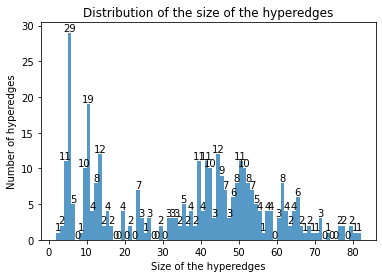

<Figure size 432x288 with 0 Axes>

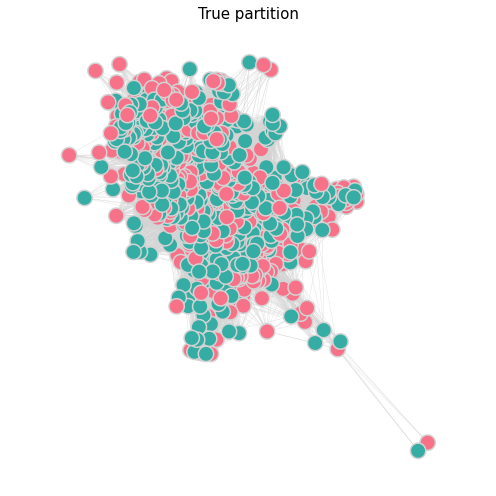

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


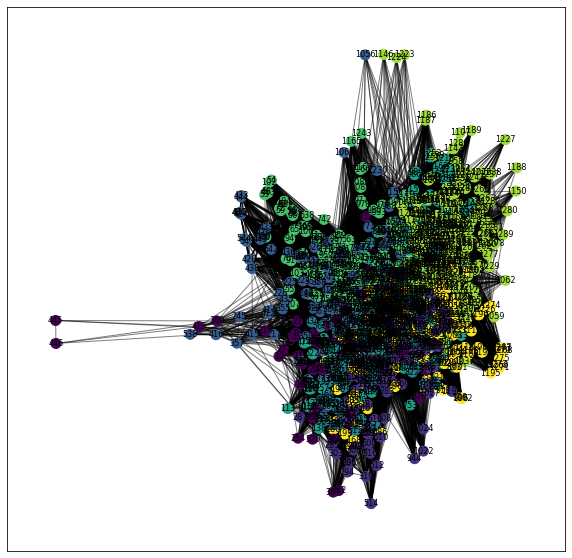

Adjusted Rand Index (ARI): 0.0014717171655690177
Normalized Mutual Information (NMI): 0.0014811227383791806
Conductance: 0.6118208939788705
Generalized Conductance: 628.1200961628512


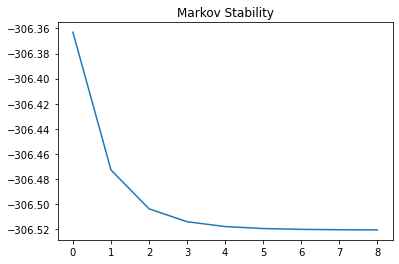

Number of partitions of K -clique reduction:  8
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0009713022455947475
Normalized Mutual Information (NMI): 0.0008805635339436184
Conductance: 0.6941277768612654
Generalized Conductance: 854.7874325368095


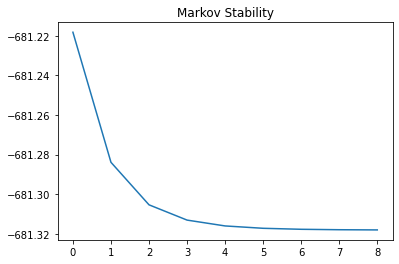

Number of partitions of K -clique reduction weighting the hyperedges:  7
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.002597030730409162
Normalized Mutual Information (NMI): 0.0025490359066251914
Conductance: 0.7252234328981401
Generalized Conductance: 901.0632879424186
Number of partitions:  11
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.001553386849610441
Normalized Mutual Information (NMI): 0.0026943043874938905
Conductance: 0.9053700111853197
Generalized Conductance: 1040.212830499869
Number of partitions:  11
-----------------------------------------------------------------------------------
Spectral clustering with number

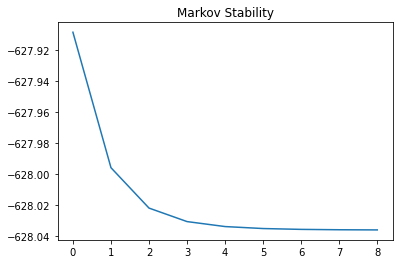

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0008868010767601381
Normalized Mutual Information (NMI): 0.0019018415459419857
Conductance: 0.7789102836300179
Generalized Conductance: 679.2934444529793


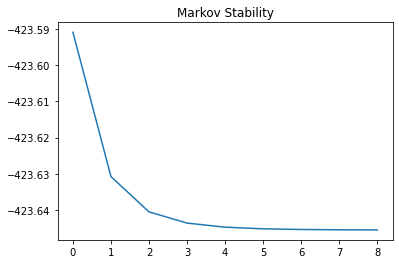

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


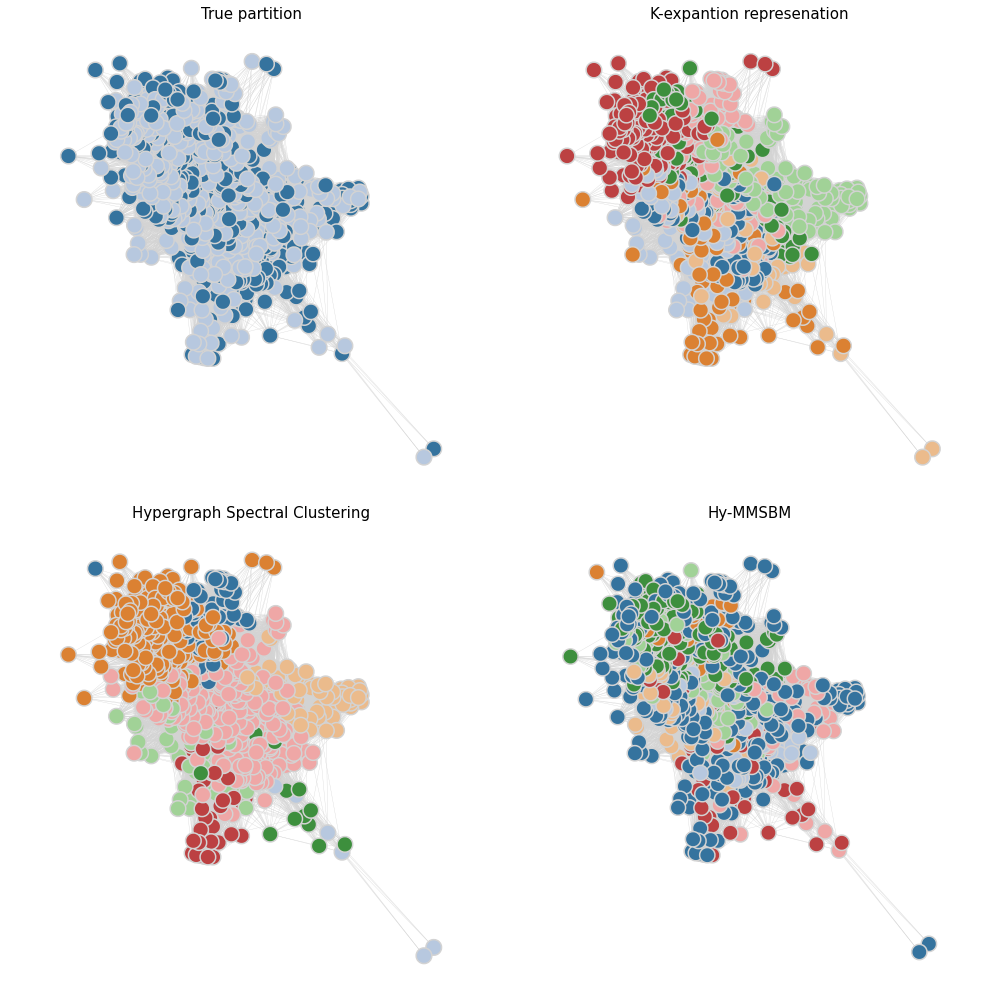

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -8.002364892513942e-05
Normalized Mutual Information (NMI): 0.0005042055580820664
Conductance: 0.24561059342815106
Generalized Conductance: 96.4577455359781


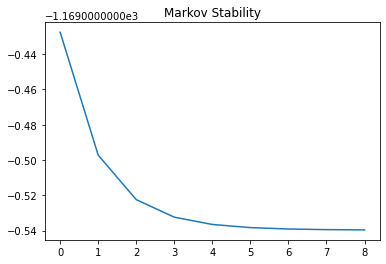

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0007052582003865199
Normalized Mutual Information (NMI): 3.817025990581517e-06
Conductance: 0.5459046085731536
Generalized Conductance: 106.16685851665852


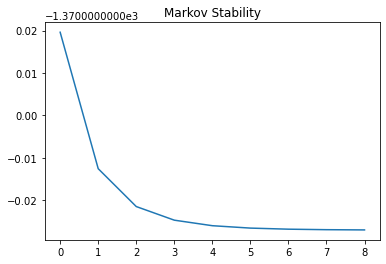

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


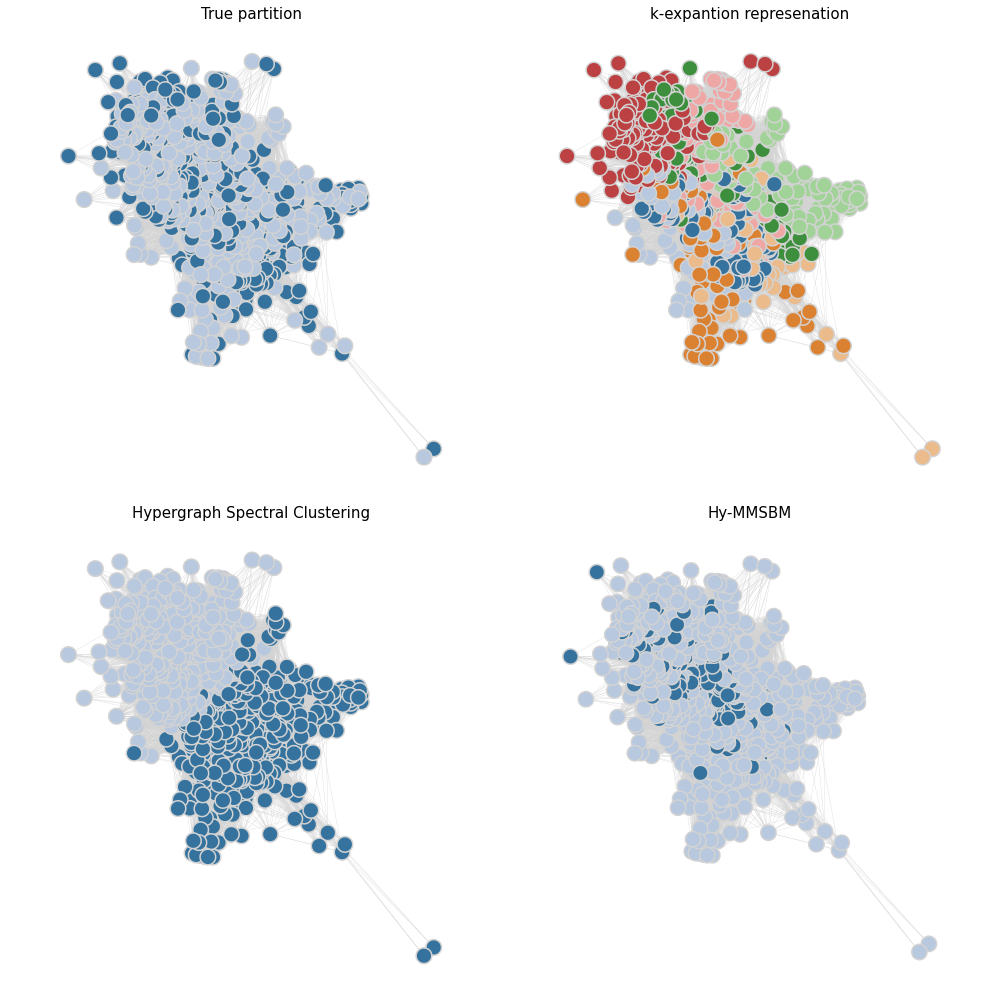

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


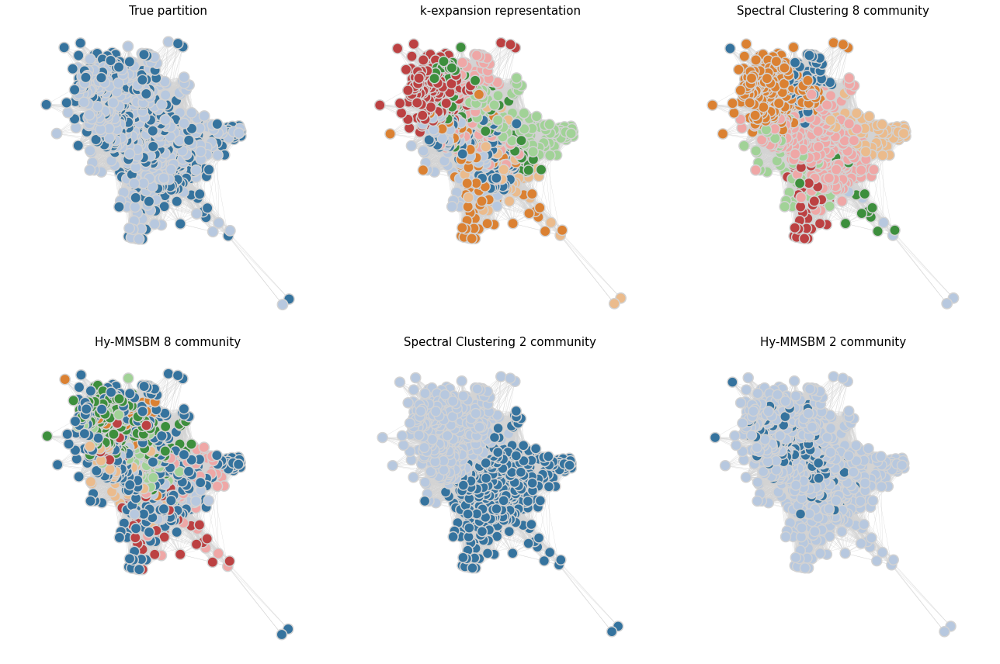

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -8.002364892513942e-05
Normalized Mutual Information (NMI): 0.0005042055580820664
Conductance: 0.24561059342815106
Generalized Conductance: 96.4577455359781
Number of communities:  3
Adjusted Rand Index (ARI): -0.00025024929845064226
Normalized Mutual Information (NMI): 0.0005009098063131234
Conductance: 0.4621942131325845
Generalized Conductance: 233.6172980948448


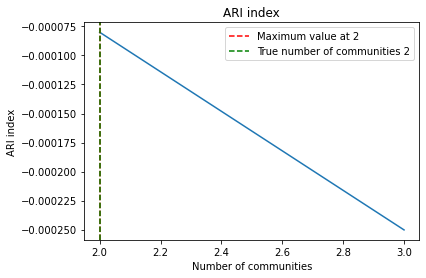

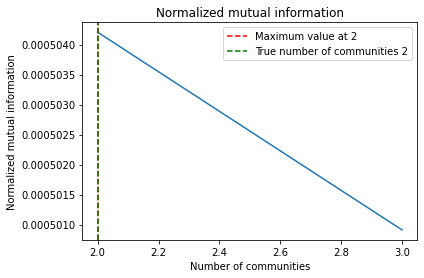

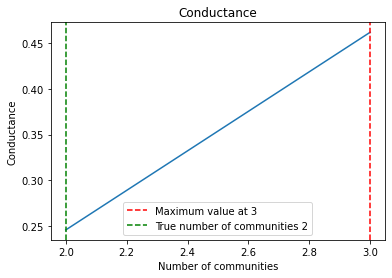

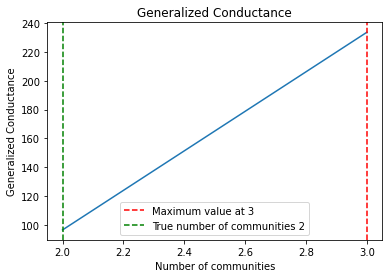

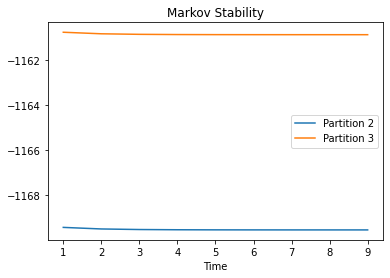

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0007684108959144905
Normalized Mutual Information (NMI): 3.5277530442659605e-07
Conductance: 0.5244873552489572
Generalized Conductance: 99.74774142842436
Adjusted Rand Index (ARI): -0.0004772736998200415
Normalized Mutual Information (NMI): 0.0010494345721049636
Conductance: 0.5713739427748785
Generalized Conductance: 95.0372739774146


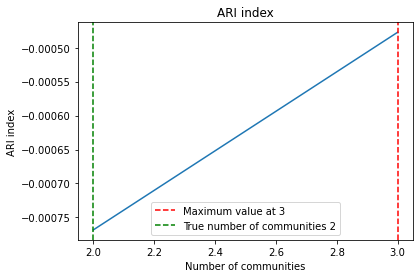

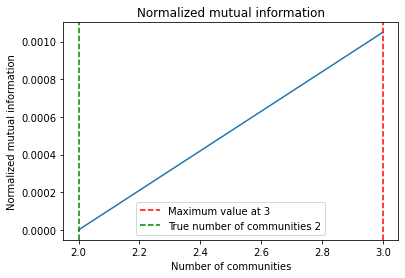

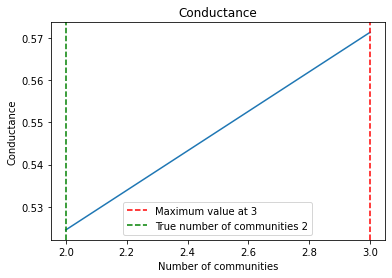

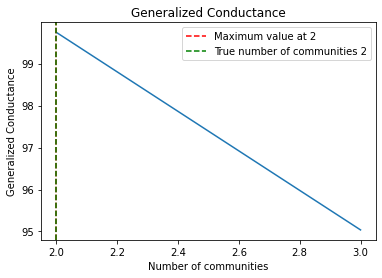

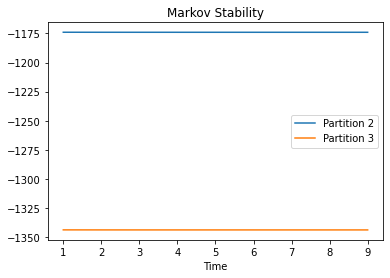

In [27]:
empirical_analysis_project(committee_house_hyperedges, true_partition_congress_committies,
                           true_matrix_congress_committies, min_number, max_number, number_community,number_community)

The number of nodes is 1290


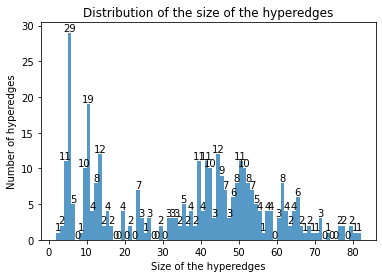

<Figure size 432x288 with 0 Axes>

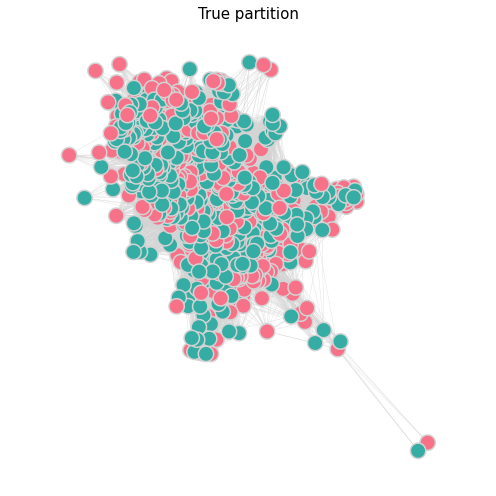

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


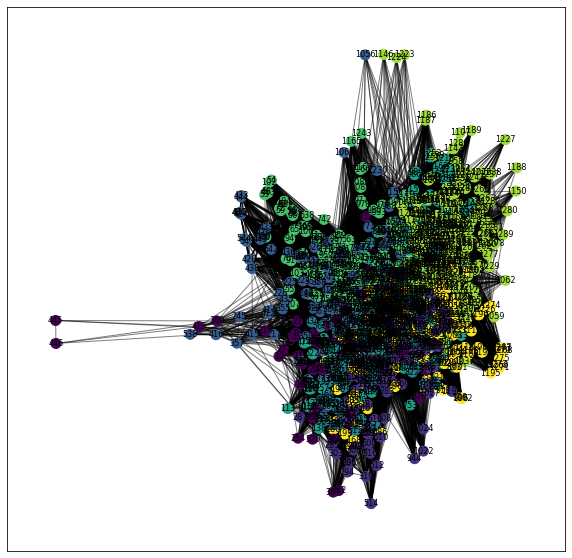

Adjusted Rand Index (ARI): 0.0014717171655690177
Normalized Mutual Information (NMI): 0.0014811227383791806
Conductance: 0.6118208939788705
Generalized Conductance: 628.1200961628512


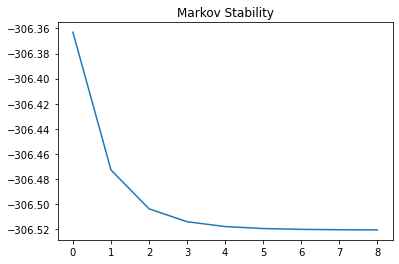

Number of partitions of K -clique reduction:  8
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0009713022455947475
Normalized Mutual Information (NMI): 0.0008805635339436184
Conductance: 0.6941277768612654
Generalized Conductance: 854.7874325368095


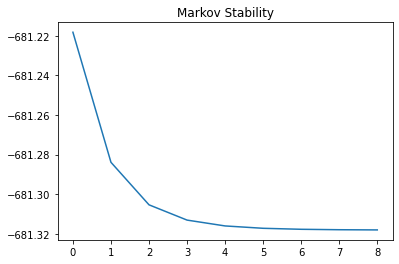

Number of partitions of K -clique reduction weighting the hyperedges:  7
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.002597030730409162
Normalized Mutual Information (NMI): 0.0025490359066251914
Conductance: 0.7252234328981401
Generalized Conductance: 901.0632879424186
Number of partitions:  11
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.001553386849610441
Normalized Mutual Information (NMI): 0.0026943043874938905
Conductance: 0.9053700111853197
Generalized Conductance: 1040.212830499869
Number of partitions:  11
-----------------------------------------------------------------------------------
Spectral clustering with number

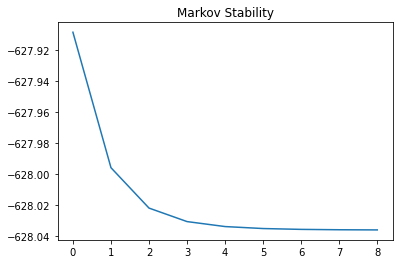

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0012198591122534845
Normalized Mutual Information (NMI): 0.00027823126426425483
Conductance: 0.8054408533234161
Generalized Conductance: 653.4385109134754


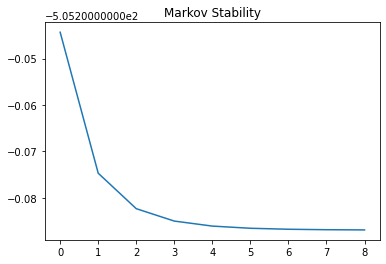

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


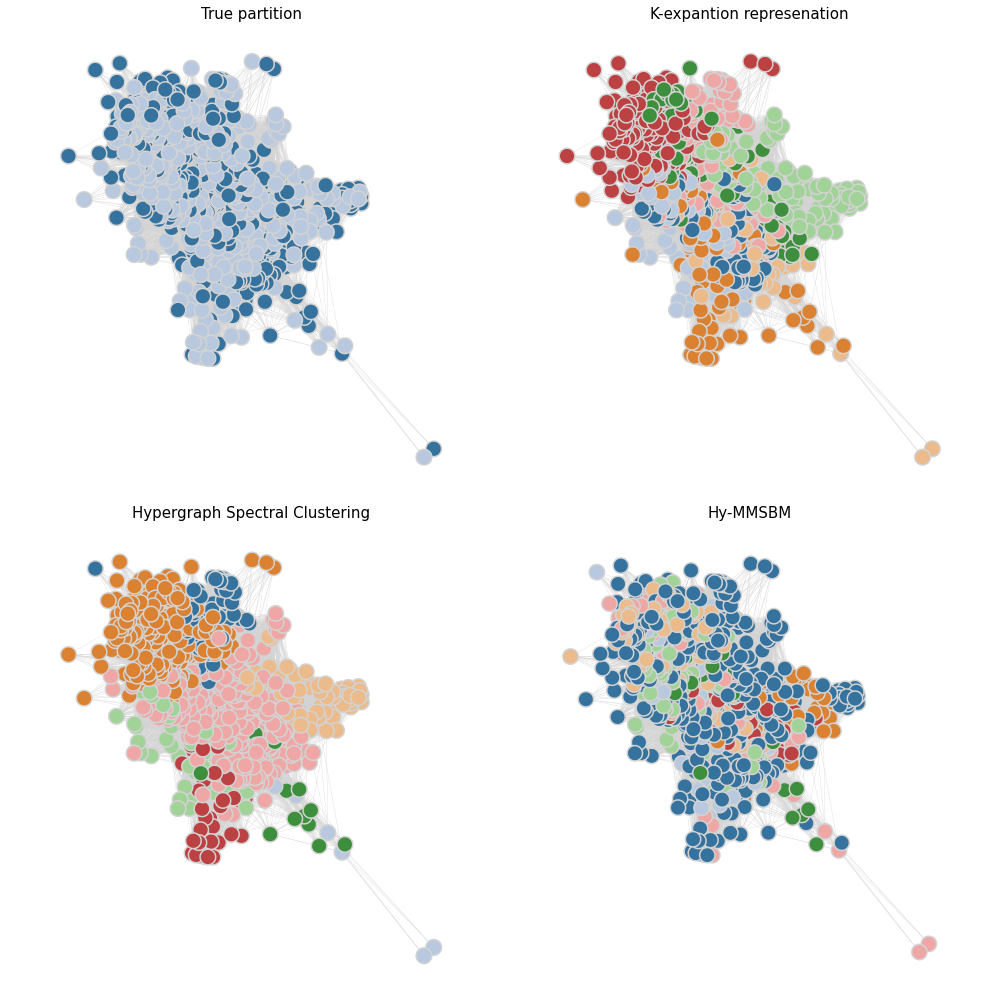

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -8.002364892513942e-05
Normalized Mutual Information (NMI): 0.0005042055580820664
Conductance: 0.24561059342815106
Generalized Conductance: 96.4577455359781


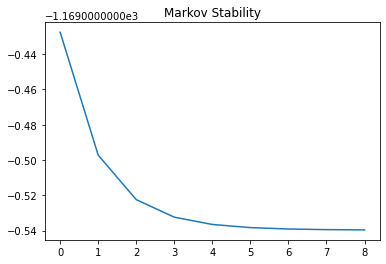

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0005605827598501833
Normalized Mutual Information (NMI): 0.001578102243659637
Conductance: 0.6271368451603541
Generalized Conductance: 132.18666587748194


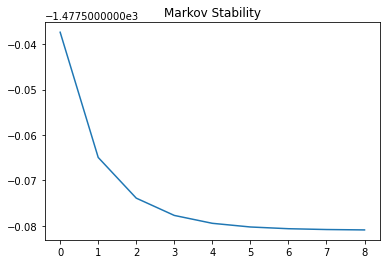

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


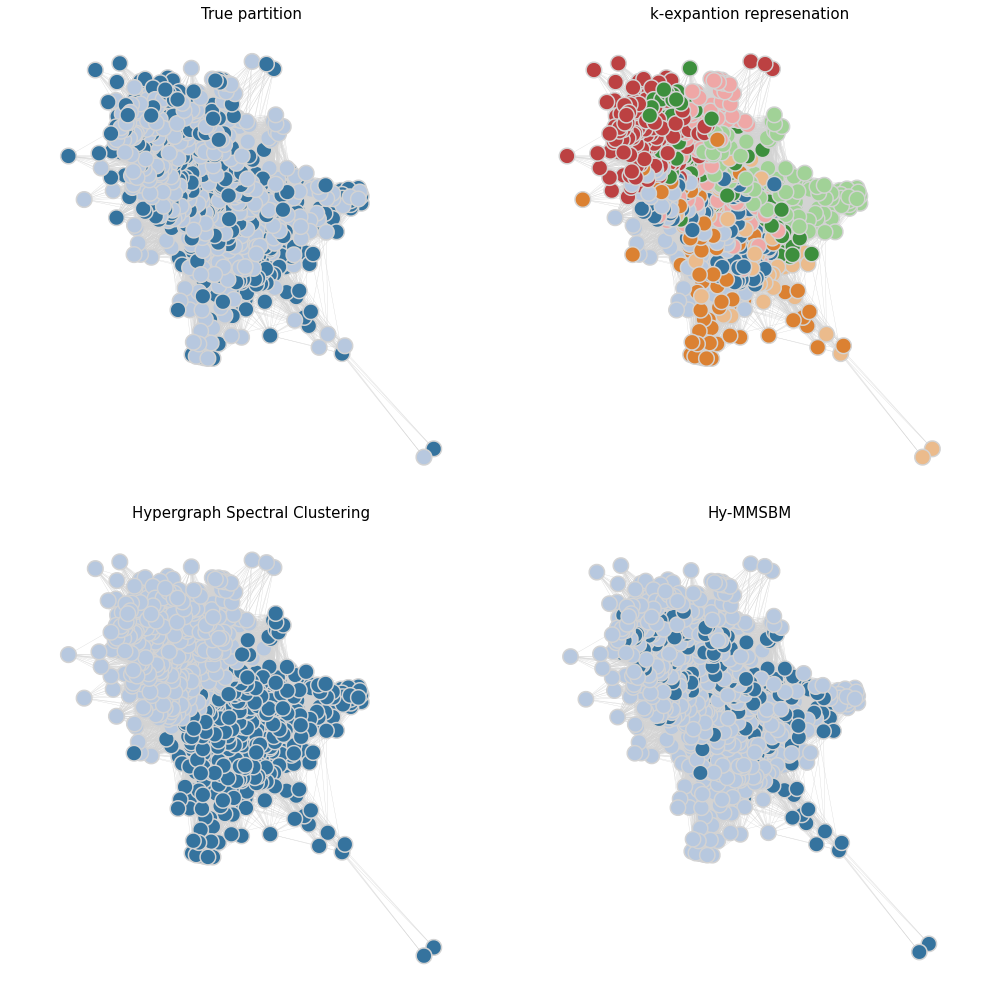

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


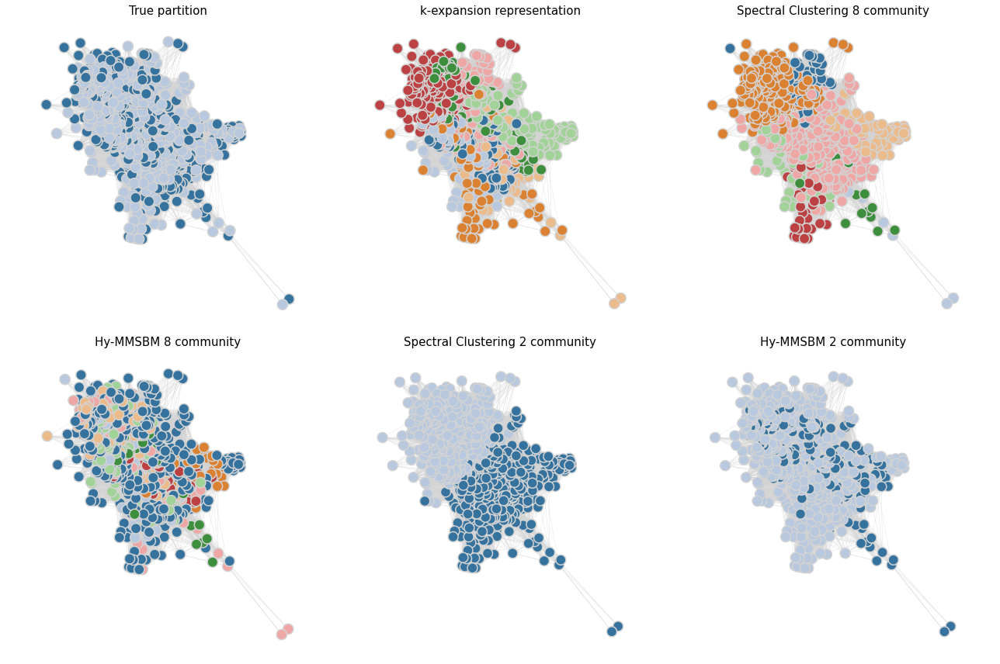

-----------------------------------------------------------------------------------
Different assortative
-----------------------------------------------------------------------------------


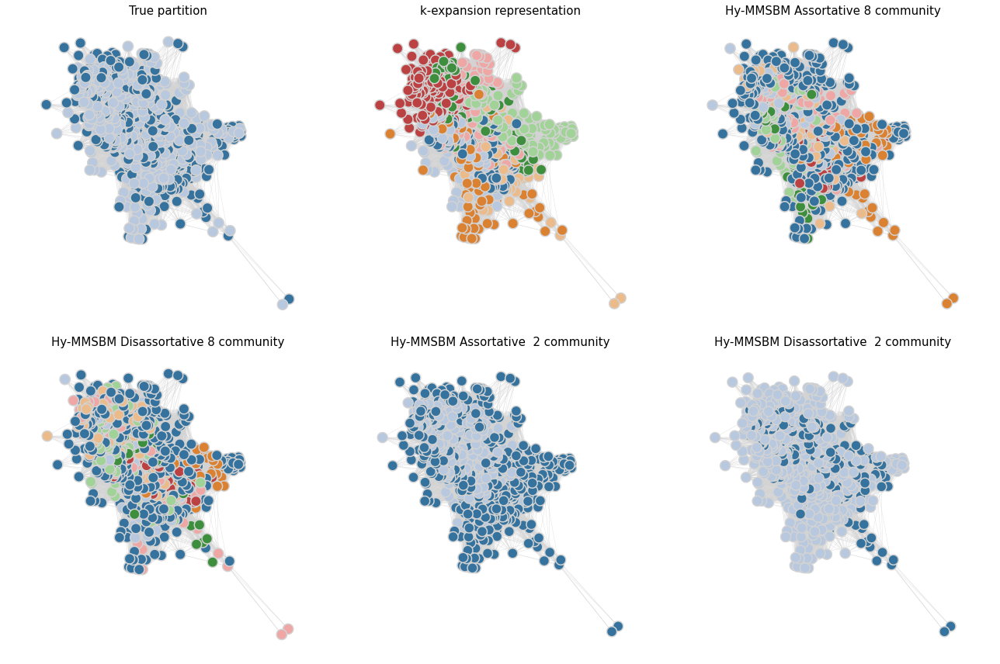

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -8.002364892513942e-05
Normalized Mutual Information (NMI): 0.0005042055580820664
Conductance: 0.24561059342815106
Generalized Conductance: 96.4577455359781
Number of communities:  3
Adjusted Rand Index (ARI): -0.00025024929845064226
Normalized Mutual Information (NMI): 0.0005009098063131234
Conductance: 0.4621942131325845
Generalized Conductance: 233.6172980948448


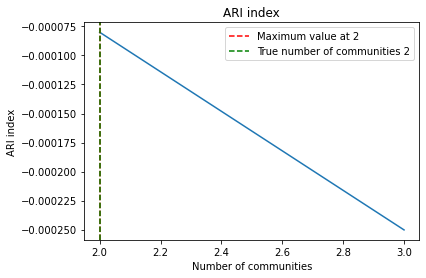

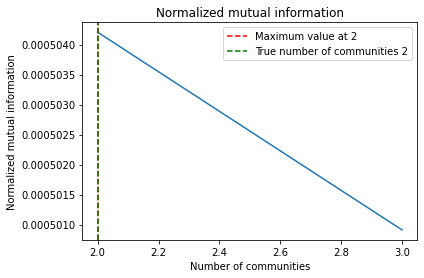

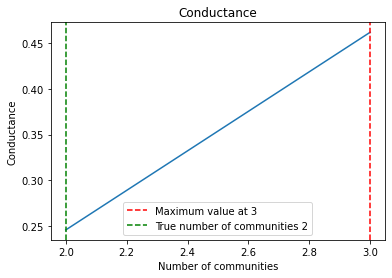

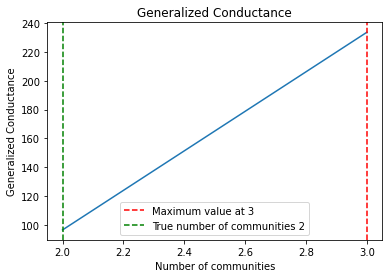

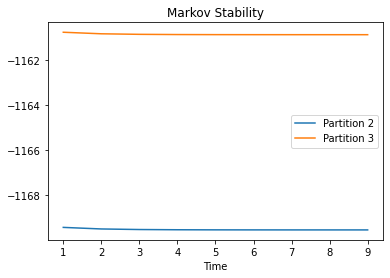

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.0009789697718067918
Normalized Mutual Information (NMI): 0.0004958444674871757
Conductance: 0.6239059917987637
Generalized Conductance: 150.2788365956129
Adjusted Rand Index (ARI): -0.0007543526815106978
Normalized Mutual Information (NMI): 2.5306297652617097e-05
Conductance: 0.5429993489720057
Generalized Conductance: 125.0097758700796


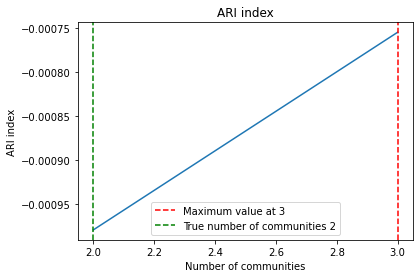

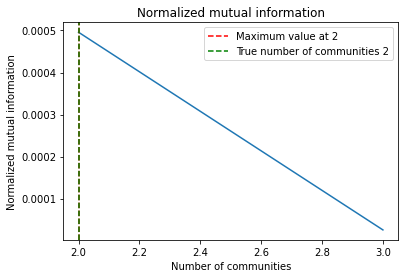

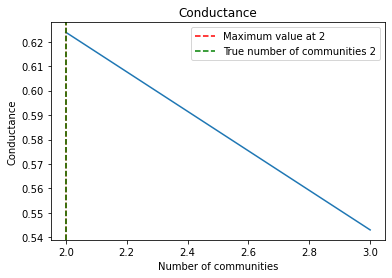

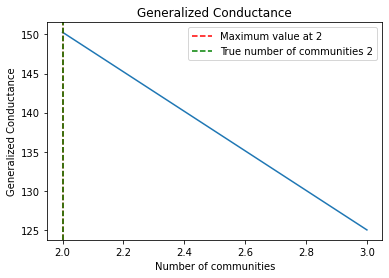

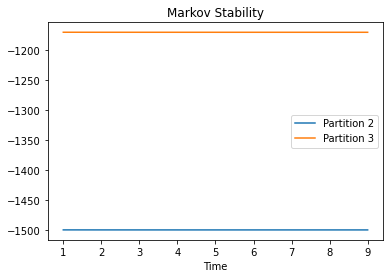

In [28]:
empirical_analysis_project(committee_house_hyperedges, true_partition_congress_committies,
                           true_matrix_congress_committies, min_number, max_number, number_community,number_community,assortative=False)

## Ernon

In [29]:
file_path_ernon = '../data/ernon/enron-email.npz'
file_path_ground_truth_ernon = '../data/ernon/enron-email_meta.csv'
hyperedges_ernon = import_from_npz(file_path_ernon)

In [30]:
data = pd.read_csv(file_path_ground_truth_ernon)
map = {'periphery': 0, 'core': 1}
data['CorePeriphery'] = data['CorePeriphery'].map(map)
true_community = {}
true_matrix = {}
for i in range(len(data)):
    if data['CorePeriphery'][i] not in true_community:
        true_community[data['CorePeriphery'][i]] = []
    true_community[data['CorePeriphery'][i]].append(data['nodeID'][i])
    true_matrix[data['nodeID'][i]] = data['CorePeriphery'][i]

number_community = len(true_community)
matrix = np.zeros((len(true_matrix), number_community))
for i in range(len(true_matrix)):
    matrix[i][true_matrix[i]-1] = 1

true_partition_ernon = true_community
true_matrix_ernon = matrix

number_community = true_matrix_ernon.shape[1]


In [31]:
print("True number of communities ernon: ", number_community)
min_number = 2
max_number = 6

True number of communities ernon:  2


The number of nodes is 4423


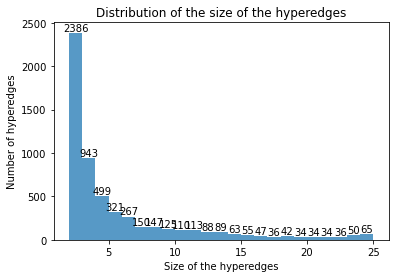

<Figure size 432x288 with 0 Axes>

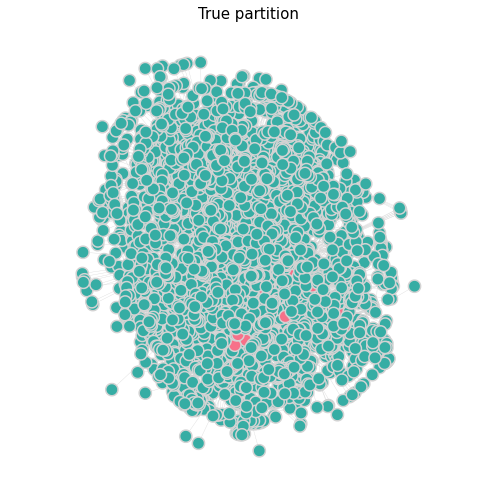

-----------------------------------------------------------------------------------
K -clique reduction
-----------------------------------------------------------------------------------


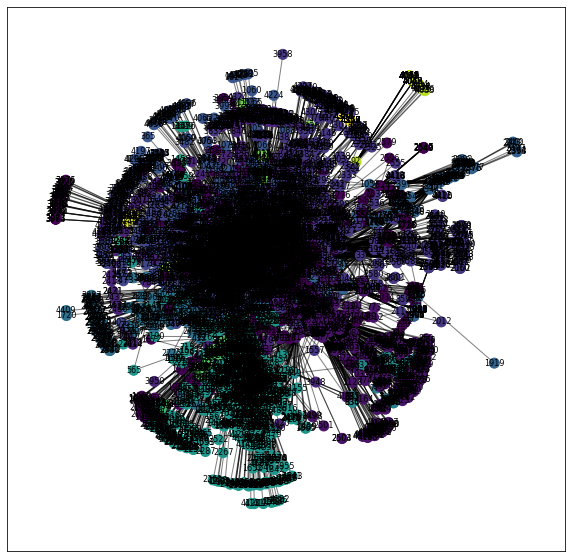

Adjusted Rand Index (ARI): 0.0008426159057189288
Normalized Mutual Information (NMI): 0.002220969428240639
Conductance: 0.1966220887887174
Generalized Conductance: 36.17482811074285


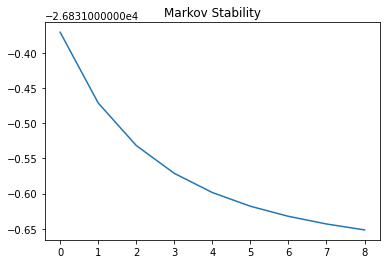

Number of partitions of K -clique reduction:  20
-----------------------------------------------------------------------------------
K -clique reduction weighting the hyperedges
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.001979153780456858
Normalized Mutual Information (NMI): 0.001226826985270285
Conductance: 0.39346051314434155
Generalized Conductance: 78.15779202503191


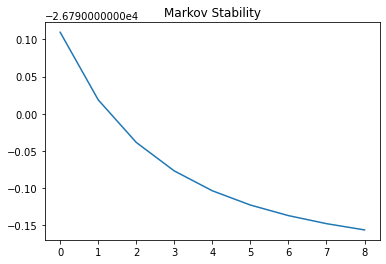

Number of partitions of K -clique reduction weighting the hyperedges:  20
-----------------------------------------------------------------------------------
Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.000356741410015338
Normalized Mutual Information (NMI): 0.0020470320434723493
Conductance: 0.31149958672418154
Generalized Conductance: 43.031487627053345
Number of partitions:  35
-----------------------------------------------------------------------------------
Weighted Bipartite representation
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.003364336778639541
Normalized Mutual Information (NMI): 0.001409966580404355
Conductance: 0.5315494760569696
Generalized Conductance: 110.85691796364453
Number of partitions:  30
-----------------------------------------------------------------------------------
Spectral clustering with numb

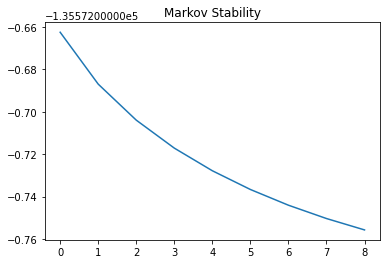

-----------------------------------------------------------------------------------
HyMMSBM with number of community of modularity
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.016452877468294692
Normalized Mutual Information (NMI): 0.0039880025909686334
Conductance: 0.7083276899359292
Generalized Conductance: 126.52674875506894


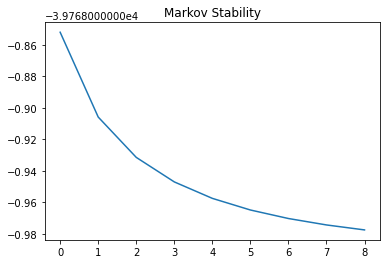

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


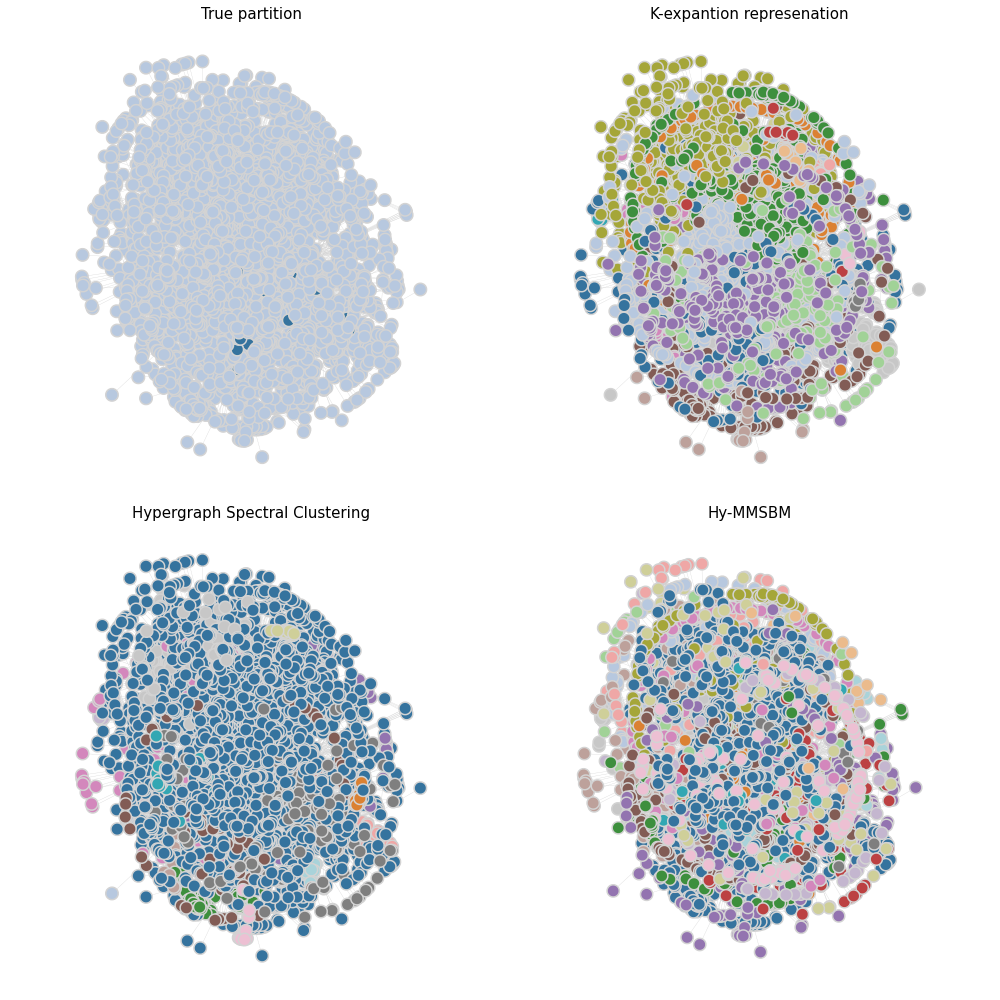

-----------------------------------------------------------------------------------
Spectral clustering with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): -0.007497697141461296
Normalized Mutual Information (NMI): 0.0003186135067877885
Conductance: 0.09616775126536514
Generalized Conductance: 9.347878330099714


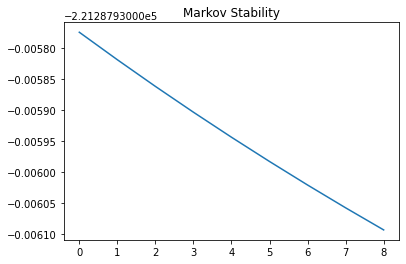

-----------------------------------------------------------------------------------
HyMMSBM with true number of clusters
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.0043890907727515876
Normalized Mutual Information (NMI): 0.00027728178503476836
Conductance: 0.38041492428240836
Generalized Conductance: 15.099163226011784


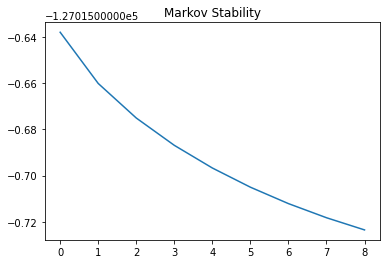

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


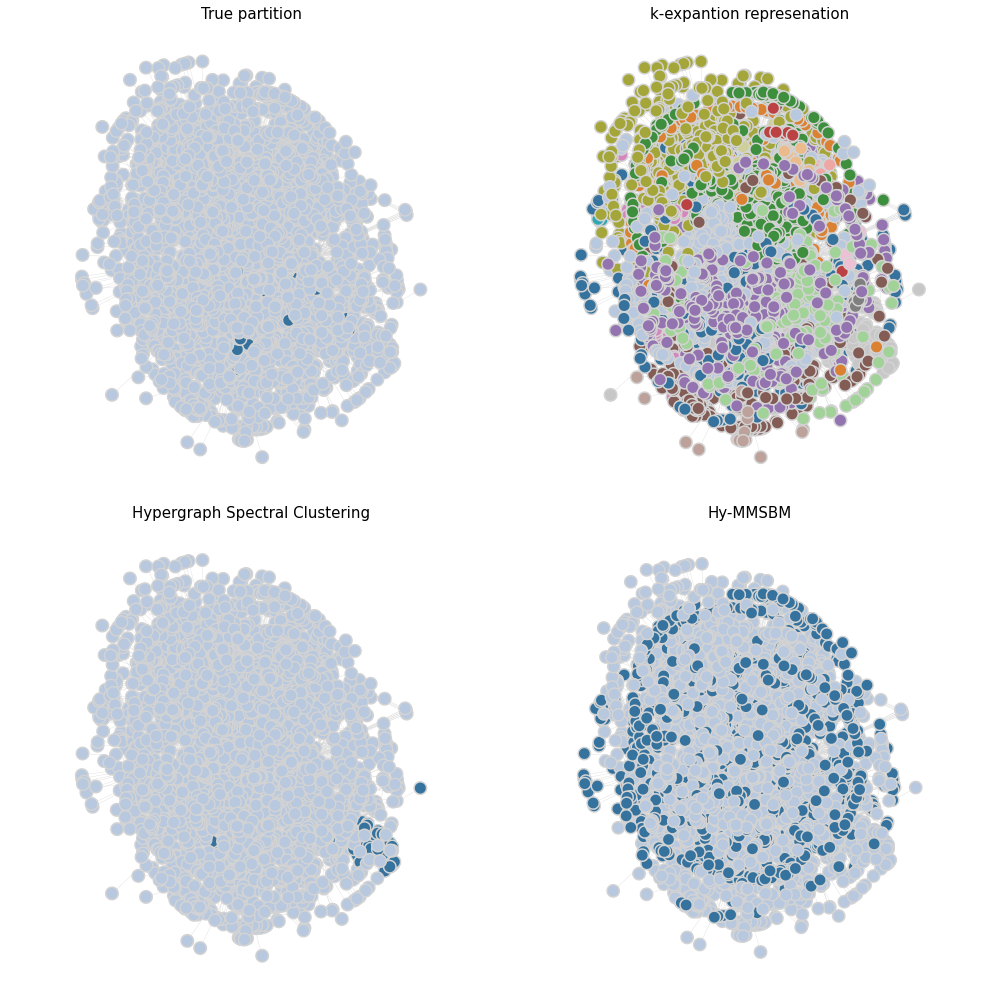

-----------------------------------------------------------------------------------
Comparison of the different methods
-----------------------------------------------------------------------------------


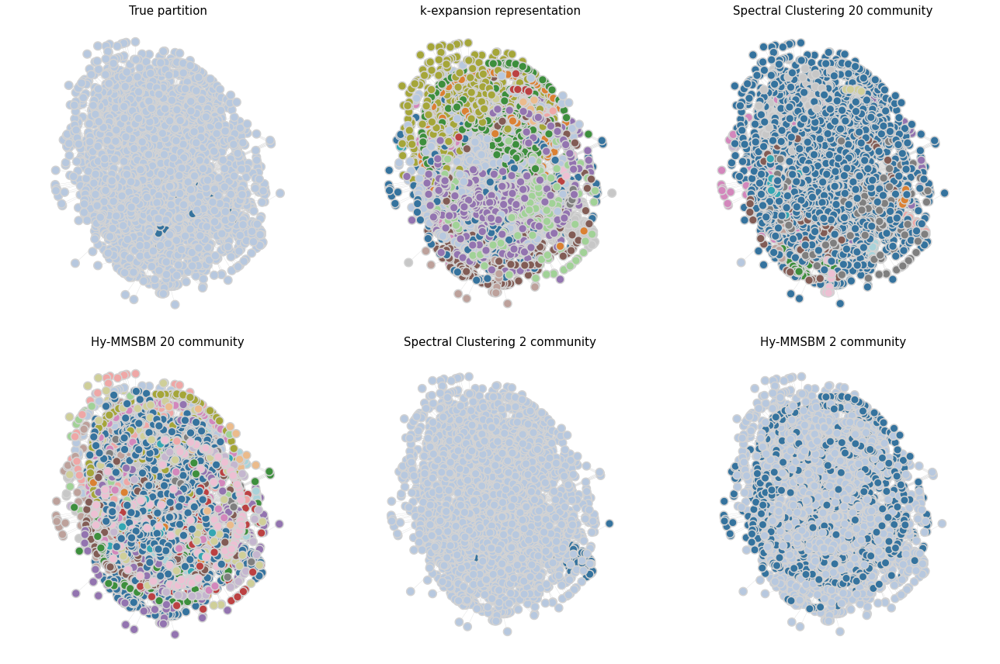

-----------------------------------------------------------------------------------
Spectral clustering choose of K
-----------------------------------------------------------------------------------
Number of communities:  2
Adjusted Rand Index (ARI): -0.007497697141461296
Normalized Mutual Information (NMI): 0.0003186135067877885
Conductance: 0.09616775126536514
Generalized Conductance: 9.347878330099714
Number of communities:  3
Adjusted Rand Index (ARI): 0.034012716037681606
Normalized Mutual Information (NMI): 0.0031014455816105657
Conductance: 0.23273526854956575
Generalized Conductance: 14.915241132584933
Number of communities:  4
Adjusted Rand Index (ARI): 0.035206384690431004
Normalized Mutual Information (NMI): 0.0031024633893253256
Conductance: 0.19334910591975746
Generalized Conductance: 14.447606630062268
Number of communities:  5
Adjusted Rand Index (ARI): 0.03856195227136677
Normalized Mutual Information (NMI): 0.0034720535806355775
Conductance: 0.20884007256359544
Gener

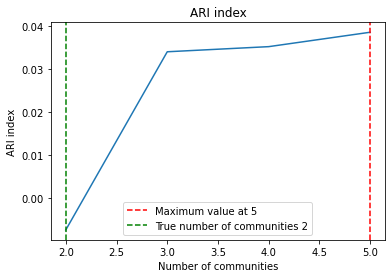

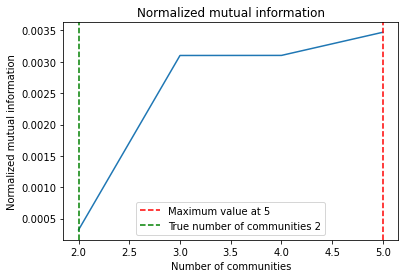

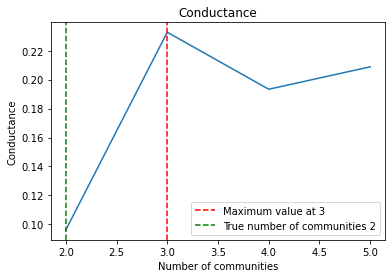

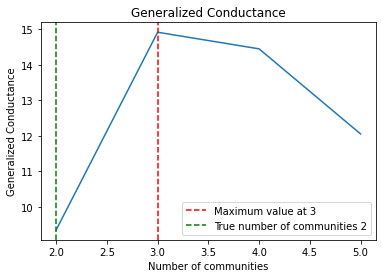

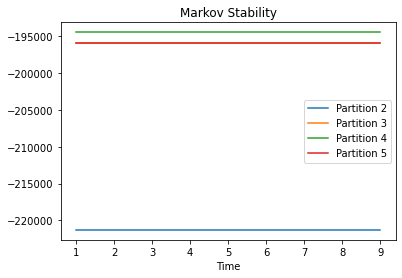

-----------------------------------------------------------------------------------
HyMMSBM choose of K
-----------------------------------------------------------------------------------
Adjusted Rand Index (ARI): 0.01088163351827975
Normalized Mutual Information (NMI): 0.0011903167223432927
Conductance: 0.3980792057839646
Generalized Conductance: 14.95620098489491
Adjusted Rand Index (ARI): 0.012047594490269022
Normalized Mutual Information (NMI): 0.0021947163820370246
Conductance: 0.48120576375377155
Generalized Conductance: 19.03562988413589
Adjusted Rand Index (ARI): 0.015506236926727479
Normalized Mutual Information (NMI): 0.0015269299115700087
Conductance: 0.4702161597271877
Generalized Conductance: 14.933768238426566
Adjusted Rand Index (ARI): 0.016956178342146373
Normalized Mutual Information (NMI): 0.004112699956563131
Conductance: 0.4162898306867178
Generalized Conductance: 18.108768942824113


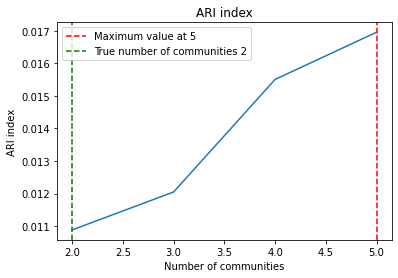

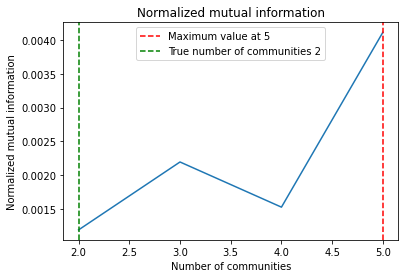

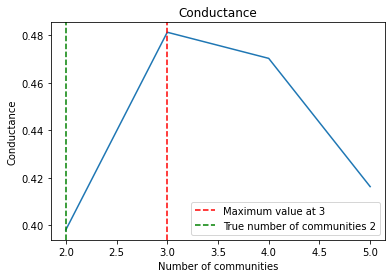

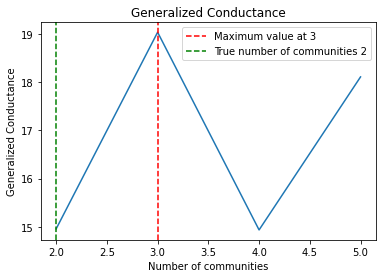

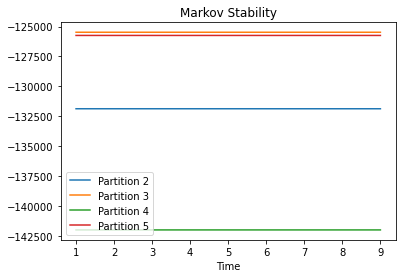

In [32]:
empirical_analysis_project(hyperedges_ernon, true_partition_ernon,
                           true_matrix_ernon, min_number, max_number, number_community, number_community)